In [1]:
%%capture
!pip install pydna
!pip install pandas
!pip install --upgrade xlrd
!pip install teemi

In [2]:
import IPython.core.display
import itertools
import pandas as pd
import pydna
import pydna.editor
import pydna.primer
import pydna.dseqrecord
import pydna.amplify
import pydna.assembly
import pydna.gel
import pydna.ladders

# 09_2_BUILD_CombinatorialLibrary

<a target="_blank" href="https://colab.research.google.com/github/hiyama341/teemi/blob/main/colab_notebooks/09_2_BUILD_CombinatorialLibrary.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

We can import the data repository like this: 

In [3]:
!git clone https://github.com/hiyama341/G8H_CPR_library.git

fatal: destination path 'G8H_CPR_library' already exists and is not an empty directory.


## 0. Overview


In this notebook, we aim to generate a second targeted combinatorial library of gene combinations from the predictions we made in [08_2_DESIGN_TargetedLibrary.ipynb](../colab_notebooks/08_2_DESIGN_TargetedLibrary.ipynb) and then stochastically sample it to identify the highest producing combination of genes. It is similiar to the first library we made in [05_1_BUILD_CombinatorialLibrary_AllStrains](05_1_BUILD_CombinatorialLibrary_AllStrains.ipynb) but this time we have lower sequence space. A schematic representation of the genes can be viewed below. 

To make the targeted combinatorial library we use the previously generated MIA-HA-1 (that does not contain G8H or CPR) as the background strain which was made in notebook [04_1_BUILD_Background_strain.ipynb](../colab_notebooks/04_1_BUILD_Background_strain.ipynb). 
Addionally we use series of PCR amplified promoters, G8H and CPR homologs as repair templates for in vivo assembly with a CRISPR plasmid integrating these elements into the well-characterized XI-2 loci. 


# 1. Project overview

## 1.1 Hypothesis
1. Specific combinations of CPR / G8H homologs and corresponding expression levels can remove the G8H bottleneck in the Strictosidine pathway

### 1.1.1 Aim: To test the hypothesis through library design

Tasks
1. analyse seq data from first library construction
2. **2nd Library**
    - investigate parts already in the lab
    - create parts missing
    - pool together parts
    - transformation
4. Phenotyping
5. Data analysis

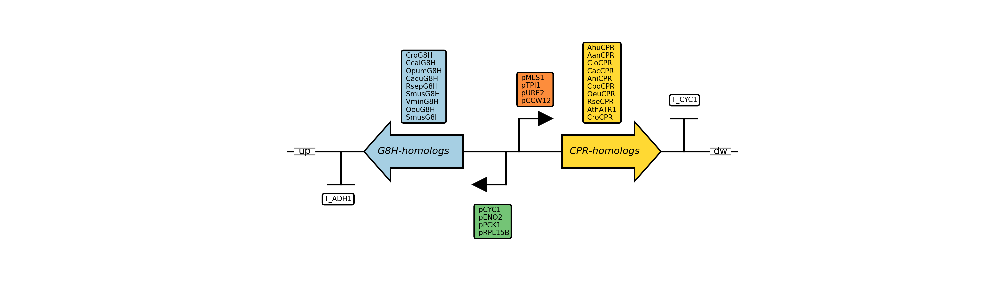

In [4]:
IPython.core.display.Image('G8H_CPR_library/data/10-plots/02_1_Combinatorial_library/Genetic construct w dnaplotlib.png', width=2000)

The figure above illustrates the original library design.

Note on sequence homology: 
- As G8H and CPR parts have homology this library cannot be made in one-pot transformation. Instead it is made in 8*10 individual transformation to not add two G8H or CPR homologs in one transformation mixtures.

Machine learning pred:
- In the following, the machine learning outcome can be found. It was found that 140 strains (5 * 2 * 2 * 7) was suitable for the pupose.
- From the predictions, the following genes have been selected: 
    - Smus, Vmin, Cro, Rsep, Oeu
    - pCYC1, pENO2
    - Clo, Ara, Rse, Aan, Cro, Ani, Ahu
    - pTPI1, pCCW12

Experiment:
- To perform this experiment, a total of 35 (5*7) transformation should be performed 
- To perform this, each gene has several different overhangs and these are pooled together. All promoters are also pooled together. UP, DW and cTRP1 is pooled together. Then the correct mixes should be performed. 

# 2. Experiment prep

To facilitate CRISPR/Cas9 transformation we need the following: 
- Plasmids to be purified:
    - gRNA plasmid
- Strains to use:
    - MIA-HA1 strains

### 2.1 Background strain for insertion

In [5]:
from Bio import SeqIO
HA1 = SeqIO.read("G8H_CPR_library/data/03-strain_sequences/background_and_controls/HA1.gb", "gb")
HA1.annotations['topology'] = "linear"

A new stock is made from the base Y1A1 (MIA-HA-1b) -> YPD media with 200 ul cell stock. (the same strains used in 05-SDP-AllLibraries)
The cells were plated on YPD before preparing precultures. 

For the third transformation I made a new stock of MIA-HA-1b 14/09

### 2.2 Plasmid with gRNA: 
- pESC-URA-gRNA_XI2-2


- From LabCollecter the location of the E.coli strain with the plasmid can be found. 
    - LAB collection ID: 9652, box: BD, pos: B7
    
    
- A new stock must be made. 
    - Grow in LB+amp (4x5ml) (here in yeast trp + amp)
    - make miniprep
    
    - Perforned twice. 

In [6]:
from teemi.lims.csv_database import get_dna_from_plate_name

In [7]:
pgRNA = get_dna_from_plate_name('pCfB-56(pESC-LEU-gRNA_ATF1-CroCPR).fasta', 'plasmid_plates', database_path = 'G8H_CPR_library/data/06-lims/csv_database/')
pgRNA.name = "pESC-URA-gRNA_XI2-2"
pgRNA

SeqRecord(seq=Seq('TGGCGGGTGTCGGGGCTGGCTTAACTATGCGGCATCAGAGCAGATTGTACTGAG...TGT'), id='10004.0', name='pESC-URA-gRNA_XI2-2', description='seq_AA4vOQs1 <unknown description>', dbxrefs=[])

In [8]:
##Extract gRNA information and save the cut sequence
XI2_2_gRNA = pydna.dseqrecord.Dseqrecord("ACCCCCCTCAACTGATCAAC", name = "XI2-2_gRNA")
pgRNA.annotations['batches']

[{'location': 'plasmid_plates_0_A5', 'volume': 134.0, 'concentration': 103.0}]

### 2.3 Control plasmids

In [9]:
#2. import plasmids need for controls
path = 'G8H_CPR_library/data/06-lims/csv_database/'
genbank_path = 'G8H_CPR_library/data/06-lims/genbank_files/'

#2. import plasmids need for controls - TRP
TRP_plasmid = get_dna_from_plate_name('pRS414.gb', 'plasmid_plates', database_path = path, genbank = True, genbank_files_path =genbank_path )
TRP_plasmid.name = 'pL_01_C2_(pRS414-TRP)'

### URA
URA_plasmid = get_dna_from_plate_name('pRS416.gb', 'plasmid_plates', database_path = path, genbank = True, genbank_files_path =genbank_path )
URA_plasmid.name = 'pL_01_C4_(pRS416-URA)'

### 2.4  Templates names 

In [10]:
G8H_template_names = ['CcalG8H_tADH1',
                     'CroG8H_tADH1',
                     'OpumG8H_tADH1',
                     'CacuG8H_tADH1',
                     'RsepG8H_tADH1',
                     'SmusG8H_tADH1',
                     'VminG8H_tADH1',
                     'OeuG8H_tADH1']

pG8H_template_names = ['pCYC1','pENO2']

CPR_template_names = ["CroCPR_tCYC1",
                      "AanCPR_tCYC1",
                      "AthATR1_tCYC1",
                      "CloCPR_tCYC1",
                      "RseCPR_tCYC1",
                      "AhuCPR_tCYC1",
                      "AniCPR_tCYC1",
                      "CacCPR_tCYC1",
                      "OeuCPR_tCYC1",
                      "CpoCPR_tCYC1"]

pCPR_template_names = ['pCCW12','pTPI1']

### 2.5 Importing all library sequences

In [11]:
from teemi.lims.csv_database import get_dna_from_box_name

In [12]:
path = 'G8H_CPR_library/data/06-lims/csv_database/'
genbank_path = 'G8H_CPR_library/data/06-lims/genbank_files/'

# Up and DW and Marker
UP_sites = [get_dna_from_box_name('UP_XI-2', 'ds_dna_box', database_path = path)]
DW_sites = [get_dna_from_box_name('DW_XI-2', 'ds_dna_box', database_path = path)]
marker_sites = [get_dna_from_box_name('seq_3HMRtcpy', 'ds_dna_box', database_path = path)]

# We can loop through the database to find our sequences - these sequence we need to 
G8H_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path, genbank = True, genbank_files_path =genbank_path ) for name in G8H_template_names]  
CPR_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path, genbank = True, genbank_files_path =genbank_path) for name in CPR_template_names]  

pG8H_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path,genbank = True, genbank_files_path = genbank_path) for name in pG8H_template_names]  
pCPR_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path, genbank = True, genbank_files_path = genbank_path) for name in pCPR_template_names]  

# 3. Targeted library




From the notebook [08_2_DESIGN_TargetedLibrary](08_2_DESIGN_TargetedLibrary.ipynb) we got 140 combinations from 20 predictions as seen below:



G8H:  ['Rsep', 'Smus', 'Oeu', 'Vmin', 'Cro']

pG8H: ['ENO2', 'CYC1']

pCPR: ['TPI1', 'CCW12']

CPR:  ['Clo', 'Ara', 'Rse', 'Aan', 'Cro', 'Ani', 'Ahu']


Number of combinations: 5 x 2 x 2 x 7 =  140


In [13]:
#Provide annotations and names for parts. 
G8H_CDS_annotations = ["OeuG8O",
                       "CroG8O",
                       "Rsep_G8O_opt",
                       "Vmin_G8O_opt",
                       "Smus_G8O_opt"]

G8H_site_names = ["OeuG8H_tADH1", 
                  "CroG8H_tADH1",
                  "RsepG8H_tADH1", 
                  "VminG8H_tADH1", 
                  "SmusG8H_tADH1"]

pG8H_annotations = ['pCYC1','pENO2']
pG8H_names = ['pCYC1','pENO2']

pCPR_annotations = ['pCCW12','pTPI1']
pCPR_names = ['pCCW12','pTPI1']

CPR_CDS_annotations = ['Cro CPR',
                       'Aan CPR',
                       'ATR1 Arabidopsis CPR',
                       'CloCPR_opt2','RseCPR_opt2',
                       'AhuCPR_opt2','AniCPR_opt2']

CPR_site_names = ['CroCPR_tCYC1',
                  'AanCPR_tCYC1',
                  'AraCPR_tCYC1',
                  'CloCPR_tCYC1',
                  'RseCPR_tCYC1',
                  'AhuCPR_tCYC1',
                  'AniCPR_tCYC1']


marker_cassette_annotations = ["TRP1_marker"]
marker_cassette_names = ["cTRP1"]

In [14]:
CPR_sites[2].name = 'AraCPR_tCYC1'

In [15]:
# Lets import some teemi functions to help with the construction of the combinatorial library
from teemi.utils import multiply_list
from teemi.design.cloning import extract_sites, plate_plot , casembler

In [16]:
from Bio.Seq import Seq
# promoters
pG8H_sites = extract_sites(pG8H_annotations, pG8H_sites, pG8H_names)
pCPR_sites = extract_sites(pCPR_annotations, pCPR_sites, pCPR_names)

In [17]:
# Reverse complementing the promoters
pG8H_sites = [site.reverse_complement(annotations=True,name=True, id= True) for site in pG8H_sites]
pG8H_sites

[SeqRecord(seq=Seq('TATTAATTTAGTGTGTGTATTTGTGTTTGTGTGTCTATAGAAGTATAGTAATTT...CTG'), id='10033', name='pCYC1', description='<unknown description>', dbxrefs=[]),
 SeqRecord(seq=Seq('TATTATTGTATGTTATAGTATTAGTTGCTTGGTGTTATGAAAGAAACTAAGAAA...ATT'), id='10034', name='pENO2', description='<unknown description>', dbxrefs=[])]

In [18]:
# Extracting cpr_sites
CPR_site_1 = []

for enzyme in CPR_sites: 
    if str(enzyme.name) in CPR_site_names: 
        CPR_site_1.append(enzyme)

len(CPR_site_1)

7

In [19]:
# Extracting G8H_sites
G8H_site_1 = []

for enzyme in G8H_sites: 
    if str(enzyme.name) in G8H_site_names: 
        G8H_site_1.append(enzyme)

len(G8H_site_1)

5

## 3.1 Overview of the targeted library

In [20]:
from teemi.utils import multiply_list

In [21]:
#Create a list of fragments within a list of parts.
fragment_list = [UP_sites,G8H_site_1,pG8H_sites,pCPR_sites,CPR_site_1,marker_sites,DW_sites]

#The number of fragments to be assembled
no_frags = len(fragment_list)
print("Number of fragments:", no_frags)

#The number of parts of each fragment
no_parts = [len(l) for l in fragment_list]
print("Number of parts: ",no_parts)

#The number of possible combinations
no_combs = multiply_list(no_parts)
print("Number of possible combinations:",no_combs)

#How many repitions are needed?
repetition_list = [int(no_comb/no_part) for no_comb, no_part in zip([no_combs]*len(no_parts),no_parts)]
print("The number of time each fragment must be repeated:", repetition_list)

#Matrix with all combinations
combinations_matrix = [t for t in itertools.product(*fragment_list)]
for row in combinations_matrix:
    names = []
    for element in row:
        names.append(element.name)
    #print(names)

Number of fragments: 7
Number of parts:  [1, 5, 2, 2, 7, 1, 1]
Number of possible combinations: 140
The number of time each fragment must be repeated: [140, 28, 70, 70, 20, 140, 140]


Fragments have been amplified in a previous part of this project (but performed by me), and the amount remaining must be checked. 


## 3.2 Primers and Amplicons for the targeted library


In [22]:
from teemi.design.teselagen_helpers import primer_matrix_teselagen, amplicon_matrix_teselagen
from teemi.design.cloning import seq_to_annotation
from teemi.utils import remove_duplicates_with_name_attribute 

In [23]:
#Read files with primer and parts information
lea_primers = pd.read_excel("G8H_CPR_library/data/04-genetic_parts/Teselagen/G8H_CPR_library.xls", sheet_name = "all primers").reset_index(drop=True)
lea_parts = pd.read_excel("G8H_CPR_library/data/04-genetic_parts/Teselagen/G8H_CPR_library.xls", sheet_name = "all parts").reset_index(drop=True)

Next we can import two helper functions to read the teselagen output. 

The outcome of the following function is just a list of list with tuples that correspond to the primers for each fragment (for each strain)

In [24]:
primer_matrix = primer_matrix_teselagen(lea_primers,lea_parts, combinations_matrix, no_combs, no_frags)

In [25]:
amplicon_matrix = amplicon_matrix_teselagen(lea_parts,primer_matrix,combinations_matrix, no_combs, no_frags)

In [26]:
#Create a matrix with lists of fragments and remove dublicates
amplicon_matrix_reshaped = [list(x) for x in zip(*amplicon_matrix)]
amplicon_matrix_reshaped_no_duplicates = [remove_duplicates_with_name_attribute(lst) for lst in amplicon_matrix_reshaped]

In [27]:
print("Fragments needed for the experiment:")
print("Name", '\t\t', "Part name", '\t', "location")
for frag_list_no, frag_list in enumerate(amplicon_matrix_reshaped_no_duplicates):
    print("All parts for fragment no: " + str(frag_list_no+1))
    for frag in frag_list:
        print(frag.name, '\t', frag.template.name, '\t', frag.annotations['batches'][0]['location'])
    print()


Fragments needed for the experiment:
Name 		 Part name 	 location
All parts for fragment no: 1
PCR_UP_tADH1_01 	 UP_XI-2 	 l5_I08

All parts for fragment no: 2
PCR_G8H_21 	 CroG8H_tADH1 	 l5_C05
PCR_G8H_22 	 CroG8H_tADH1 	 l5_C06
PCR_G8H_09 	 RsepG8H_tADH1 	 l5_B02
PCR_G8H_10 	 RsepG8H_tADH1 	 l5_B03
PCR_G8H_05 	 SmusG8H_tADH1 	 l5_A07
PCR_G8H_06 	 SmusG8H_tADH1 	 l5_A08
PCR_G8H_01 	 VminG8H_tADH1 	 l5_A03
PCR_G8H_02 	 VminG8H_tADH1 	 l5_A04
PCR_G8H_29 	 OeuG8H_tADH1 	 l5_D04
PCR_G8H_30 	 OeuG8H_tADH1 	 l5_D05

All parts for fragment no: 3
PCR_PRO_01 	 pCYC1 	 l4_C07
PCR_PRO_06 	 pENO2 	 l4_D03

All parts for fragment no: 4
PCR_PRO_02 	 pCCW12 	 l4_C08
PCR_PRO_04 	 pTPI1 	 l4_D01

All parts for fragment no: 5
PCR_CPR_31 	 CroCPR_tCYC1 	 l5_E06
PCR_CPR_40 	 AanCPR_tCYC1 	 l5_F01
PCR_CPR_33 	 AraCPR_tCYC1 	 l5_F05
PCR_CPR_39 	 CloCPR_tCYC1 	 l5_F09
PCR_CPR_32 	 RseCPR_tCYC1 	 l5_G04
PCR_CPR_36 	 AhuCPR_tCYC1 	 l5_G08
PCR_CPR_37 	 AniCPR_tCYC1 	 l5_H03
PCR_CPR_11 	 CroCPR_tCYC1 	 l5_E04
P

The genes should be represented in dublicates, as they each have an overlap to a promoter. To easen the transformation, the two gene parts are pooled together. The same goes for the promoters, and UP, DW and cTRP1. 

In [28]:
amplicons = [item for sublist in amplicon_matrix_reshaped_no_duplicates for item in sublist]
print("Number of parts to be used:", len(amplicons))

Number of parts to be used: 31


# 4. Create new parts/Amplifying parts
Since there are some leftovers of parts, their volume were check. 
There were parts I made previously (single) and there were parts of genes that had been pooled (Sørens) 
I used as many of the single parts, because Sørens also containrf overhangs from two other promoters that were not used here. To save time, those were the single ones are missing, Sørens was used. 

Refer to section [Test amounts needed vs what is available](#Test_amounts_needed_vs_what_is_available)

## 4.1 Parts missing 1:  AraCPR_tCYC1, pCCW12, pTPI1
- L4_C8 (pCCW12)
- L4_D1 (pTPI1)
- l5_F05 (AraCPR_tCYC1)
- l5_F03 (AraCPR_tCYC1)

o3_F07: PR_G8H_01
GAGCGACCTCATGCTATAC




o3_F08: PR_CPR_02
TTCTCAAGCAAGGTTTTCAG

In [29]:
from teemi.build.PCR import amplicon_by_name

In [30]:
parts_missing = [amplicon_by_name('PCR_CPR_33', amplicons), amplicon_by_name('PCR_CPR_13', amplicons), amplicon_by_name('PCR_PRO_02', amplicons), amplicon_by_name('PCR_PRO_04', amplicons)]
for part in parts_missing:
    print(part.name,'\n', part.annotations,'\n')

PCR_CPR_33 
 {'molecule_type': 'DNA', 'template_name': 'AraCPR_tCYC1', 'batches': [{'location': 'l5_F05', 'volume': 100.0, 'concentration': 20.0}], 'ta Q5 Hot Start': 61} 

PCR_CPR_13 
 {'molecule_type': 'DNA', 'template_name': 'AraCPR_tCYC1', 'batches': [{'location': 'l5_F03', 'volume': 100.0, 'concentration': 10.0}], 'ta Q5 Hot Start': 61} 

PCR_PRO_02 
 {'molecule_type': 'DNA', 'template_name': 'pCCW12', 'batches': [{'location': 'l4_C08', 'volume': 100.0, 'concentration': 100.0}], 'ta Q5 Hot Start': 61} 

PCR_PRO_04 
 {'molecule_type': 'DNA', 'template_name': 'pTPI1', 'batches': [{'location': 'l4_D01', 'volume': 100.0, 'concentration': 90.0}], 'ta Q5 Hot Start': 58} 



PCR from previous:
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Create according to protocol
- Elongation time: 1.5 min (30 s/ kb)
- Annealing temp 58
    - All primers are designed to have 3' Tm 59C-54C, and Ta 59C-62C when using  Q5 2x MasterMix (calculated with NEB Tm calculator)

In [31]:
from teemi.build.PCR import calculate_processing_speed, calculate_elongation_time, Q5_NEB_PCR_program

Adding annotations to the PCRs

In [32]:
pol = 'Q5 Hot Start'
for amplicon in amplicons:
    amplicon.annotations['polymerase'] = pol
    amplicon = calculate_processing_speed(amplicon)
    amplicon = calculate_elongation_time(amplicon)
    amplicon.template.annotations['batches'] = [{'location'    :'o5',
                                 'volume'       : 100,
                                 'concentration': 100}]

In [33]:
#Find the length of the longest amplicon to determine the PCR time
longest_amplicon = 0
for amp in parts_missing:
    if len(amp) > longest_amplicon: longest_amplicon = len(amp)
print("Length of longest amplicon: \t" + str(longest_amplicon) + " bp")
print("Elongation time: \t\t"  + str(round(longest_amplicon/1000 * 35,1))+ " seconds")

Length of longest amplicon: 	2298 bp
Elongation time: 		80.4 seconds


Lets get the plate locations with the set_plate_location function and then make it into a dataframe

In [34]:
from teemi.build.PCR import set_plate_locations

In [35]:
plate_locations = set_plate_locations(parts_missing)

In [36]:
amplicon_e_df = pd.DataFrame(plate_locations, columns=['name', 'location','template_name','template_location','fw_name','fw_location','rv_name','rv_location'])
amplicon_e_df = amplicon_e_df.set_index('name')
amplicon_e_df

,location,template_name,template_location,fw_name,fw_location,rv_name,rv_location
name,,,,,,,
NaN,l5_F05,AraCPR_tCYC1,o5,PR_CPR_32,op4_H03,PR_CPR_02,op4_B10
NaN,l5_F03,AraCPR_tCYC1,o5,PR_CPR_14,op4_F03,PR_CPR_02,op4_B10
NaN,l4_C08,pCCW12,o5,PR_PRO_03,op4_B11,PR_PRO_04,op4_B12
NaN,l4_D01,pTPI1,o5,PR_PRO_07,op4_D11,PR_PRO_08,op4_D12


In [37]:
from teemi.build.PCR import calculate_volumes

In [38]:
calculate_volumes(vol_p_reac = 50, 
        no_of_reactions = 9,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_9_reac
Template,1.0,9.0
Primer 1,2.5,22.5
Primer 2,2.5,22.5
H20,19.0,171.0
Pol,25.0,225.0
Total,50.0,450.0


In [39]:
for part in parts_missing:
    print("PCR program for", part.name)
    l = Q5_NEB_PCR_program(part)
    print(l)

PCR program for PCR_CPR_33
|98°C|98°C               |    |tmf:73.0
|____|_____          72°C|72°C|tmr:60.0
|30 s|10s  \ 61.0°C _____|____|30s/kb
|    |      \______/ 1: 9|2min|GC 41.7%
|    |       20s         |    |2298bp

PCR program for PCR_CPR_13
|98°C|98°C               |    |tmf:71.0
|____|_____          72°C|72°C|tmr:60.0
|30 s|10s  \ 61.0°C _____|____|30s/kb
|    |      \______/ 1: 9|2min|GC 41.6%
|    |       20s         |    |2298bp

PCR program for PCR_PRO_02
|98°C|98°C               |    |tmf:80.0
|____|_____          72°C|72°C|tmr:63.0
|30 s|10s  \ 64.0°C _____|____|30s/kb
|    |      \______/ 0:31|2min|GC 44.6%
|    |       20s         |    |1023bp

PCR program for PCR_PRO_04
|98°C|98°C               |    |tmf:81.0
|____|_____          72°C|72°C|tmr:61.0
|30 s|10s  \ 62.0°C _____|____|30s/kb
|    |      \______/ 0:32|2min|GC 38.4%
|    |       20s         |    |1043bp



PCR_CPR_33
PCR_CPR_13
PCR_PRO_02
PCR_PRO_04


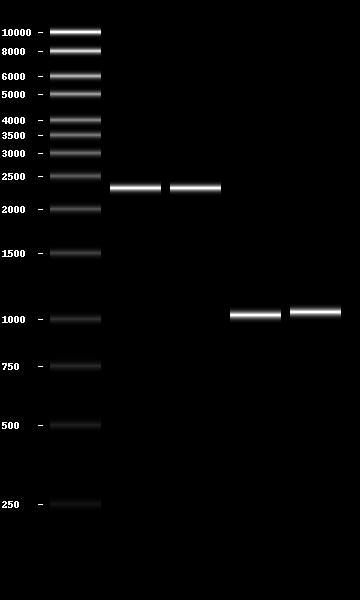

In [40]:
for band in parts_missing:
    print(band.name)
pydna.gel.gel([pydna.ladders.GeneRuler_1kb,*[[band]for band in parts_missing]])

Mini prep 
conc - values

Ara failed. Promoteres were good. 

#### Updating concentrations of PCR products

In [41]:
from teemi.build.PCR import update_amplicon_annotations

PCR_PRO_04 was pooled with an older sample. giving a concentration of 72

In [42]:
amplicon_names = ['PCR_PRO_02','PCR_PRO_04']
locations = ['l5_D01', 'l6_A5']
concentrations = [55, 72]
volumes = [30, 50]

update_amplicon_annotations(amplicon_names,amplicons, locations, concentrations,volumes  )

In [43]:
from teemi.lims.csv_database import *

In [44]:
## Add missing parts to the databse - pCCW12 and pTPI1
amplicons1_to_databse =  [amplicon_by_name('PCR_PRO_02', amplicons), amplicon_by_name('PCR_PRO_04', amplicons)]

# add unique ids
add_unique_ids(amplicons1_to_databse,path = 'G8H_CPR_library/data/06-lims/csv_database/' )

pcr_box = get_database('PCR_box', path = 'G8H_CPR_library/data/06-lims/csv_database/')
#add_sequences_to_dataframe(amplicons1_to_databse, pcr_box)
pcr_box.head()

,ID,name,date,box,row,col,size,seq,concentration,volume,features,location,reference,comments,description
0,10162.0,ATF1,09-06-2022,0,A,1,425.0,CGTGCGATTCTTTGAAAAGATAATGTATGATTATGCTTTCACTCAT...,57.0,50.0,"[SeqFeature(FeatureLocation(ExactPosition(0), ...",l4_I07,NaN,gRNA with ATF1 site to KO G8H,pcr_product_Stock of primers for G8H-CPR libra...
1,10163.0,CroCPR,09-06-2022,0,A,2,425.0,AGTGCAGGTTCTTTGAAAAGATAATGTATGATTATGCTTTCACTCA...,63.0,50.0,"[SeqFeature(FeatureLocation(ExactPosition(8), ...",l4_I08,NaN,gRNA with croCPR site to KO G8H,pcr_product_Stock of primers for G8H-CPR libra...
2,10165.0,tADH1-P1_PGK1_400,09-12-2022,0,A,3,659.0,ACTCTCGAGAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACC...,123.6,50.0,"[SeqFeature(FeatureLocation(ExactPosition(3), ...",l5_A02,NaN,ATF1_repair_template to KO G8H module,pcr_product_Stock of primers for G8H-CPR libra...
3,10168.0,XI-3,09-22-2022,0,A,4,1449.0,GTGCTTGATTTGCGTCATTCATTACCATAGTATTACTATTGGTGTT...,93.0,50.0,"[SeqFeature(FeatureLocation(ExactPosition(0), ...",l4_A08,NaN,CPR_repair_template to KO CPR module,pcr_product_Stock of primers for G8H-CPR libra...
4,10272.0,PCR_PRO_02,09-23-2022,0,A,5,1023.0,TTATCGAATGGGCATGCTCGGCGTATGGACCTGTCTAAAGAAACTT...,55.0,30.0,"[SeqFeature(FeatureLocation(ExactPosition(36),...",l5_D01,Made from designated start promoter pools,PCR_products for the second library round,pcr_product_description_description


already updated the database

In [45]:
#update_database(pcr_box, 'PCR_box', path=  'G8H_CPR_library/Data/csv_database/')

## 4.2 Parts missing 2,3,4: 

The following paragraph was made excactly like the previous (4.1) paragraph and therefore not to confuse the reader we have reduced the following to these headings with and the results: 

- Parts missing 2 = pCYC1, pCCW12, pTPI1, pENO2
- Parts missing 3 = CroCPR, AraCPR, AhuCPR, AthATR1, XI_UP, cTRP1, XI_DW
- Parts missing 4 = OeuG8H_tADH1, pCCW12, pTPI1, pCYC1, pENO2

#### Results: Agarose gel for - Parts missing 2 + 3 

In [46]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/raw/bioimager/2021-08_30_Q5_parts.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/raw/bioimager/2021-08_30_Q5_parts.jpg

The length og CPR_36 and CPR_16 (Ahu) does not match the expected length. 
They were send for sequencing with the primers used in PCR and the primer from Beata 
BJL 249 AhuCPR seq R, each primer mixed alone with the PCR product + ExoSAP
5,5 PCR + 2,2 ExoSAP 

#### Results: Agarose gel for - Parts missing 4

In [47]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/raw/bioimager/2021-09_13_Q5_parts.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/raw/bioimager/2021-09_13_Q5_parts.jpg

All parts can be purified except XI-2DW 2

# 5 Pooling parts 
## 5.1 Parts check in laboratory
Through investigatino of parts it was found that:

from Own stock I can use:
- OeuG8H_tADH1
- RsepG8H_tADH1
- VminG8H_tADH1
- SmusG8H
- AanCPR
- CloCPR
- RseCPR


from Sørens stock:
- CroG8H
- AniCPR

To be determined: 

missing:
- CroCPR
- AraCPR
- AhuCPR

Q:
- how much od I need of gRNA
- How much do I need of the up, dw, trp?
- how much promoter do I need


In [48]:
from teemi.build.transformation import wanted_volume, wanted_mass

## 5.2 Make promoter pool

In [49]:
#Save amounts needed and amplicons
promoters_amounts_total = 0.001*4
promoter_names = ('PCR_PRO_01','PCR_PRO_06','PCR_PRO_02','PCR_PRO_04')
promoter_parts_amounts_total = {k: v for (k, v) in zip(promoter_names,[promoters_amounts_total/8]*len(promoter_names))}
promoters = [amplicon_by_name(name,amplicons) for name in promoter_names]

In [50]:
# PCR_PRO_01 its actual concentration is 100
promoters[0].annotations['batches'][0]['concentration'] = 100

### Getting equimolar amounts

In [51]:
from teemi.build.transformation import calculate_volume_and_total_concentration

Now we can use the function calculate_volume_and_total_concentration() to give us equimolar conc when mixing amplicons

In [52]:
calculate_volume_and_total_concentration(promoters, promoter_parts_amounts_total)
None

name, volume, concentration, location
PCR_PRO_01 3.4 100 	 l4_C07
PCR_PRO_06 3.1 110.0 	 l4_D03
PCR_PRO_02 6.0 55 	 l5_D01
PCR_PRO_04 4.7 72 	 l6_A5
total volume:  17.2

total ngs:  1349.4
total conc:  78.45348837209303


We can also add a number to increase the total volume so we are sure we have enough for the transformations

In [53]:
calculate_volume_and_total_concentration(promoters, promoter_parts_amounts_total,n = 9)
None

name, volume, concentration, location
PCR_PRO_01 30.599999999999998 100 	 l4_C07
PCR_PRO_06 27.900000000000002 110.0 	 l4_D03
PCR_PRO_02 54.0 55 	 l5_D01
PCR_PRO_04 42.300000000000004 72 	 l6_A5
total volume:  154.8

total ngs:  12144.6
total conc:  78.45348837209302


In [54]:
amplicon_names = ['PCR_PRO_02','PCR_PRO_04', 'PCR_PRO_06', 'PCR_PRO_01' ]
locations = ['l6_B2', 'l6_B3', 'l6_B4', 'l6_B1']
concentrations = [81, 75, 88, 90, 108]
volumes = [80, 80, 80, 80]

update_amplicon_annotations(amplicon_names,amplicons,locations, concentrations,volumes  )

In [55]:
##There was not enough in 02. so a new batch was made 
amplicon_names = ['PCR_PRO_02']
locations = ['l6_B2']
concentrations = [108]
volumes = [55]

update_amplicon_annotations(amplicon_names,amplicons,locations, concentrations,volumes  )

In [56]:
#Save amounts needed and amplicons
promoters_amounts_total = 0.001*4 
promoter_names = ('PCR_PRO_01','PCR_PRO_06','PCR_PRO_02','PCR_PRO_04')
promoter_parts_amounts_total = {k: v for (k, v) in zip(promoter_names,[promoters_amounts_total/8]*len(promoter_names))}
promoters = [amplicon_by_name(name,amplicons) for name in promoter_names]

In [57]:
# PCR_PRO_01 its actual concentration is 100
promoters[0].annotations['batches'][0]['concentration'] = 100

In [58]:
calculate_volume_and_total_concentration(promoters, promoter_parts_amounts_total,n = 1)
None

name, volume, concentration, location
PCR_PRO_01 3.4 100 	 l6_B1
PCR_PRO_06 3.9 88 	 l6_B4
PCR_PRO_02 3.1 108 	 l6_B2
PCR_PRO_04 4.5 75 	 l6_B3
total volume:  14.9

total ngs:  1355.5
total conc:  90.97315436241611


In [59]:
# PCR_PRO_01 its actual concentration is 90 
promoters[0].annotations['batches'][0]['concentration'] = 90

In [60]:
print('first pool')
calculate_volume_and_total_concentration(promoters, promoter_parts_amounts_total,n = 9)
None

first pool
name, volume, concentration, location
PCR_PRO_01 33.300000000000004 90 	 l6_B1
PCR_PRO_06 35.1 88 	 l6_B4
PCR_PRO_02 27.900000000000002 108 	 l6_B2
PCR_PRO_04 40.5 75 	 l6_B3
total volume:  136.8

total ngs:  12136.500000000002
total conc:  88.7171052631579


In [61]:
# There was not enough in the first pool so i made a little more
print('Extra pool')
calculate_volume_and_total_concentration(promoters, promoter_parts_amounts_total, n = 1.5)
None

Extra pool
name, volume, concentration, location
PCR_PRO_01 5.550000000000001 90 	 l6_B1
PCR_PRO_06 5.85 88 	 l6_B4
PCR_PRO_02 4.65 108 	 l6_B2
PCR_PRO_04 6.75 75 	 l6_B3
total volume:  22.8

total ngs:  2022.75
total conc:  88.71710526315789


In [62]:
# There was not enough in the first pool so i made a little more
print('Second pool')
calculate_volume_and_total_concentration(promoters, promoter_parts_amounts_total,n = 7)
None

Second pool
name, volume, concentration, location
PCR_PRO_01 25.900000000000002 90 	 l6_B1
PCR_PRO_06 27.3 88 	 l6_B4
PCR_PRO_02 21.7 108 	 l6_B2
PCR_PRO_04 31.5 75 	 l6_B3
total volume:  106.4

total ngs:  9439.5
total conc:  88.71710526315789


In [63]:
from teemi.build.PCR import nanophotometer_concentrations

In [64]:
from teemi.utils import mean 

## 5.3 Pool Parts

### First pool of parts
These are included as some of his parts were still available

In [65]:
#Concentrations measured by søren
pool_concentrations = nanophotometer_concentrations('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/raw/nanophotometer/2021-03-29_G8H_CPR_library_part_concentrations.tsv')

# pool 2 promoter samples 88,77.6 into 82.8
concs = pool_concentrations[-5:-3]
concs_mean = sum(concs) / len(concs)
pool_concentrations = [conc for conc in pool_concentrations if conc not in concs]
pool_concentrations.insert(-3, concs_mean)
len(pool_concentrations)


# pool equimolar ratio
promoter_conc = [100,100,100,90,120,110,75,120]

# pool all, fragments are the same, same length
UP_concs = [40, 30, 30, 35, 23.7]
DW_concs = [60, 60, 40, 50, 17.5]
cTRP_concs = [160, 150, 140, 39.9]

#Information
pool_names = ['VminG8H_tADH1','SmusG8H_tADH1','RsepG8H_tADH1','CacuG8H_tADH1','OpumG8H_tADH1','CroG8H_tADH1','PcoG8H_tADH1','OeuG8H_tADH1','CcalG8H_tADH1','CroCPR_tCYC1','AanCPR_tCYC1','AraCPR_tCYC1','CloCPR_tCYC1','RseCPR_tCYC1','AhuCPR_tCYC1','AniCPR_tCYC1','CacCPR_tCYC1','OeuCPR_tCYC1','CpoCPR_tCYC1','Promoters_pool','XI-2_UP','XI-2_DW','cTRP1']
pool_lengths = [1845,1851,1845,1869,1902,1737,1412,1845,1845,2365,2335,2300,2365,2365,2365,2305,2347,2347,2260,1033,609,599,1451]
pool_bases = ['A'* pool_length for pool_length in pool_lengths]
pool_positions = ['F7','F8','F9','G1','G2','G3','G4','G5','G6','G7','G8','G9','H1','H2','H3','H4','H5','H6','H7','H8','H9','I1','I2']

# Update due pooling with previously made batches
pool_bases[-3] = amplicon_by_name('PCR_UP_tADH1_01',amplicons).seq.watson # UP
pool_bases[-2] = amplicon_by_name('PCR_TRP1-DW_02',amplicons).seq.watson # DW
pool_bases[-1] = amplicon_by_name('PCR_TRP1-DW_01',amplicons).seq.watson # cTRP

pool_concentrations[-3] = mean(UP_concs)
pool_concentrations[-2] = mean(DW_concs)
pool_concentrations[-1] = mean(cTRP_concs)

pool_volumes = [100] * len(pool_names)
pool_volumes[-3] = 100 * len(UP_concs) # UP
pool_volumes[-2] = 100 * len(DW_concs) # DW
pool_volumes[-1] = 100 * len(cTRP_concs) # cTRP

In [66]:
#Remove the parts not usefull in this project
parts_not_to_include = ['CacuG8H_tADH1','OpumG8H_tADH1','PcoG8H_tADH1','CcalG8H_tADH1','CacCPR_tCYC1','OeuCPR_tCYC1','CpoCPR_tCYC1']
for i in range(len(pool_names)-1, 0, -1):
    if pool_names[i] in parts_not_to_include:
        pool_names.pop(i)
        pool_lengths.pop(i)
        pool_bases.pop(i)
        pool_positions.pop(i)
        pool_volumes.pop(i)
        pool_concentrations.pop(i)

In [67]:
#Create a dictionary that holds all the information
pools ={}
for i in range(len(pool_names)):
    pools[pool_names[i]] = {'concentration':pool_concentrations[i], 'pool_lengths':pool_lengths[i], 'pool_bases': pool_bases[i], 'pool_volumes':pool_volumes[i], 'pool_positions':pool_positions[i]}

In [68]:
from teemi.build.transformation import pool_parts, print_pooled_parts

In [69]:
# the whole library 
pool_names = ['VminG8H_tADH1','SmusG8H_tADH1','RsepG8H_tADH1','CroG8H_tADH1','OeuG8H_tADH1','CroCPR_tCYC1','AanCPR_tCYC1','AraCPR_tCYC1','CloCPR_tCYC1','RseCPR_tCYC1','AhuCPR_tCYC1','AniCPR_tCYC1','Promoters_pool','XI-2_UP','XI-2_DW','cTRP1']
pool_lengths = [1845,1851,1845,1869,1902,1737,1412,1845,1845,2365,2335,2300,2365,2365,2365,2305,2347,2347,2260,1033,609,599,1451]

# the ones we want to pool
part_names = ['OeuG8H_tADH1','RsepG8H_tADH1','VminG8H_tADH1', 'SmusG8H_tADH1', 'AanCPR_tCYC1', 'CloCPR_tCYC1','RseCPR_tCYC1']
part_amounts = [0.002, 0.0014, 0.0021, 0.0021, 0.0015, 0.0015, 0.0014]

dict_with_pooled_volumes = pool_parts(amplicons,part_names,part_amounts,  pool_names, pool_lengths)
print_pooled_parts(dict_with_pooled_volumes)

To be pooled together
RsepG8H_tADH1
PCR_G8H_09 {'volume_to_mix': 30.5, 'location': 'l5_B02', 'concentration': 55.0}
PCR_G8H_10 {'volume_to_mix': 33.6, 'location': 'l5_B03', 'concentration': 50.0}
vol 64.1
calculated con 52.379095163806554 

SmusG8H_tADH1
PCR_G8H_05 {'volume_to_mix': 63.2, 'location': 'l5_A07', 'concentration': 40.0}
PCR_G8H_06 {'volume_to_mix': 45.9, 'location': 'l5_A08', 'concentration': 55.0}
vol 109.1
calculated con 46.31072410632448 

VminG8H_tADH1
PCR_G8H_01 {'volume_to_mix': 63.0, 'location': 'l5_A03', 'concentration': 40.0}
PCR_G8H_02 {'volume_to_mix': 56.0, 'location': 'l5_A04', 'concentration': 45.0}
vol 119.0
calculated con 42.35294117647059 

OeuG8H_tADH1
PCR_G8H_29 {'volume_to_mix': 82.4, 'location': 'l5_D04', 'concentration': 30.0}
PCR_G8H_30 {'volume_to_mix': 54.9, 'location': 'l5_D05', 'concentration': 45.0}
vol 137.3
calculated con 35.997815003641655 

AanCPR_tCYC1
PCR_CPR_40 {'volume_to_mix': 45.9, 'location': 'l5_F01', 'concentration': 30.0}
PCR_CPR_2

In [70]:
#save the information from the pool (measured concentrations)
New_pools={'OeuG8H_tADH1':{'pool_location': 'l5_E04', 'pool_concentration':42},'RsepG8H_tADH1':{'pool_location': 'l5_E03', 'pool_concentration':56}, 'VminG8H_tADH1':{'pool_location': 'l4_D01', 'pool_concentration':49}, 'SmusG8H_tADH1':{'pool_location': 'l5_E05', 'pool_concentration':54},'AanCPR_tCYC1':{'pool_location': 'l5_E06', 'pool_concentration':43},'CloCPR_tCYC1':{'pool_location': 'l5_I08', 'pool_concentration':35}, 'RseCPR_tCYC1':{'pool_location': 'l5_C09', 'pool_concentration':34},'Promoters_pool':{'pool_location': 'l6_B05', 'pool_concentration':83}}
#Add the new pools to the assembly dicts
for part in New_pools:
    if part in pools:
        pools[part]['pool_positions'] = New_pools[part]['pool_location']
        pools[part]['concentration'] = New_pools[part]['pool_concentration']

First I did one pool with CPR, Ara and Ahu, but the concentrations were too low and the wuality of the parts were not good enough. Therefor a second round was made with new pools

### Second pool of parts 

pool = 'CroCPR_tCYC1','AraCPR_tCYC1','AhuCPR_tCYC1','AthATR1_tCYC1'


In [71]:
# the whole library 
pool_names = ['VminG8H_tADH1','SmusG8H_tADH1','RsepG8H_tADH1','CroG8H_tADH1','OeuG8H_tADH1','CroCPR_tCYC1','AanCPR_tCYC1','AraCPR_tCYC1','CloCPR_tCYC1','RseCPR_tCYC1','AhuCPR_tCYC1','AniCPR_tCYC1','Promoters_pool','XI-2_UP','XI-2_DW','cTRP1']
pool_lengths = [1845,1851,1845,1869,1902,1737,1412,1845,1845,2365,2335,2300,2365,2365,2365,2305,2347,2347,2260,1033,609,599,1451]

# the ones we want to pool
part_names = ['CroCPR_tCYC1','AraCPR_tCYC1','AhuCPR_tCYC1','AthATR1_tCYC1']
part_amounts = [0.003, 0.003, 0.003, 0.003]

dict_with_pooled_volumes = pool_parts(amplicons,part_names, part_amounts,  pool_names, pool_lengths)
print_pooled_parts(dict_with_pooled_volumes)

To be pooled together
CroCPR_tCYC1
PCR_CPR_31 {'volume_to_mix': 112.9, 'location': 'l5_E06', 'concentration': 30.0}
PCR_CPR_11 {'volume_to_mix': 225.8, 'location': 'l5_E04', 'concentration': 15.0}
vol 338.7
calculated con 19.999999999999996 

AraCPR_tCYC1
PCR_CPR_33 {'volume_to_mix': 179.9, 'location': 'l5_F05', 'concentration': 20.0}
PCR_CPR_13 {'volume_to_mix': 359.8, 'location': 'l5_F03', 'concentration': 10.0}
vol 539.7
calculated con 13.333333333333332 

AhuCPR_tCYC1
PCR_CPR_36 {'volume_to_mix': 227.7, 'location': 'l5_G08', 'concentration': 20.0}
PCR_CPR_16 {'volume_to_mix': 182.1, 'location': 'l5_G06', 'concentration': 25.0}
vol 409.8
calculated con 22.22181551976574 



To get a little bit lower concentration I will add water

### Third pool of parts
The second transfomration failed, and therefore more parts were needed. 

In [72]:
#Update concentration - From third part creation 13/09
amplicon_by_name('PCR_G8H_29', amplicons).annotations['batches'][0]['location'] = 'l6_A6'
amplicon_by_name('PCR_G8H_29', amplicons).annotations['batches'][0]['concentration'] = 281
amplicon_by_name('PCR_G8H_29', amplicons).annotations['batches'][0]['volume'] = 75

In [73]:
# the whole library 
pool_names = ['VminG8H_tADH1','SmusG8H_tADH1','RsepG8H_tADH1','CroG8H_tADH1','OeuG8H_tADH1','CroCPR_tCYC1','AanCPR_tCYC1','AraCPR_tCYC1','CloCPR_tCYC1','RseCPR_tCYC1','AhuCPR_tCYC1','AniCPR_tCYC1','Promoters_pool','XI-2_UP','XI-2_DW','cTRP1']
pool_lengths = [1845,1851,1845,1869,1902,1737,1412,1845,1845,2365,2335,2300,2365,2365,2365,2305,2347,2347,2260,1033,609,599,1451]

# the ones we want to pool
part_names = ['OeuG8H_tADH1','RsepG8H_tADH1','VminG8H_tADH1', 'AniCPR_tCYC1']
part_amounts = [ 0.0013, 0.0015, 0.00087, 0.0006]

dict_with_pooled_volumes = pool_parts(amplicons,part_names, part_amounts,  pool_names, pool_lengths)
print_pooled_parts(dict_with_pooled_volumes)

To be pooled together
RsepG8H_tADH1
PCR_G8H_09 {'volume_to_mix': 32.7, 'location': 'l5_B02', 'concentration': 55.0}
PCR_G8H_10 {'volume_to_mix': 36.0, 'location': 'l5_B03', 'concentration': 50.0}
vol 68.7
calculated con 52.379912663755455 

VminG8H_tADH1
PCR_G8H_01 {'volume_to_mix': 26.1, 'location': 'l5_A03', 'concentration': 40.0}
PCR_G8H_02 {'volume_to_mix': 23.2, 'location': 'l5_A04', 'concentration': 45.0}
vol 49.3
calculated con 42.352941176470594 

OeuG8H_tADH1
PCR_G8H_29 {'volume_to_mix': 5.7, 'location': 'l6_A6', 'concentration': 281}
PCR_G8H_30 {'volume_to_mix': 35.7, 'location': 'l5_D05', 'concentration': 45.0}
vol 41.4
calculated con 77.4927536231884 

AniCPR_tCYC1
PCR_CPR_37 {'volume_to_mix': 29.9, 'location': 'l5_H03', 'concentration': 30.0}
PCR_CPR_17 {'volume_to_mix': 29.9, 'location': 'l5_H01', 'concentration': 30.0}
vol 59.8
calculated con 30.0 



### Making an additional batch of promoters, UP, DW, TRP  

In [74]:
##There was not enough in 02. so a new batch was made 
amplicon_names = ['PCR_PRO_01', 'PCR_PRO_02', 'PCR_PRO_04','PCR_PRO_06' ]
locations = ['l6_B2', 'l6_D2','l6_B3', 'l6_B4' ]
concentrations = [147, 122, 170, 206]
volumes = [75, 75, 75, 75]

update_amplicon_annotations(amplicon_names,amplicons, locations, concentrations,volumes  )

In [75]:
#promoter pools
promoters_amounts_total = 0.001*4 
promoter_names = ('PCR_PRO_01','PCR_PRO_02','PCR_PRO_04','PCR_PRO_06')
promoter_parts_amounts_total = {k: v for (k, v) in zip(promoter_names,[promoters_amounts_total/4]*len(promoter_names))}
promoters = [amplicon_by_name(name,amplicons) for name in promoter_names]

print("Promoter pool")
calculate_volume_and_total_concentration(promoters, promoter_parts_amounts_total,n = 10)
None

Promoter pool
name, volume, concentration, location
PCR_PRO_01 46.0 147 	 l6_B2
PCR_PRO_02 55.0 122 	 l6_D2
PCR_PRO_04 40.0 170 	 l6_B3
PCR_PRO_06 33.0 206 	 l6_B4
total volume:  174.0

total ngs:  27070.0
total conc:  155.57471264367817


In [76]:
##There was not enough in 02. so a new batch was made 
amplicon_names = ['PCR_TRP1-DW_01', 'PCR_TRP1-DW_02', 'PCR_UP_tADH1_01' ]
locations = ['l6_D3', 'l6_D4','l6_D5']
concentrations = [240, 61, 82]
volumes = [75, 75, 75]

update_amplicon_annotations(amplicon_names,amplicons, locations, concentrations,volumes  )

In [77]:
#pool new up and dw and trp
updw_amount = 0.001
updw_names = ('PCR_UP_tADH1_01', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02')
updw_parts_amounts_total = {k: v for (k, v) in zip(updw_names,[updw_amount]*len(updw_names))}
updw = [amplicon_by_name(name,amplicons) for name in updw_names]

print("Pool new UP and DW and TRP")
calculate_volume_and_total_concentration(updw, updw_parts_amounts_total,n = 10)

# ngs divided by total volume
total_vol = 151
ngs = [3936.0, 9360.0, 3904.0]
print('\nNgs/total volume')
for i in range(len(updw_names)):
    print(updw_names[i], 'con', ngs[i]/total_vol)

Pool new UP and DW and TRP
name, volume, concentration, location
PCR_UP_tADH1_01 48.0 82 	 l6_D5
PCR_TRP1-DW_01 39.0 240 	 l6_D3
PCR_TRP1-DW_02 64.0 61 	 l6_D4
total volume:  151.0

total ngs:  17200.0
total conc:  113.90728476821192

Ngs/total volume
PCR_UP_tADH1_01 con 26.066225165562916
PCR_TRP1-DW_01 con 61.98675496688742
PCR_TRP1-DW_02 con 25.85430463576159


## 6. Transformation

#### Make strain batches

In [78]:
#Create a list of parts to be used
cro_strain_batches={'entity_name':[],'Bases':[], 'Box_barcode':[], 'position':[],'volume':[], 'volume unit':[],'concentration':[], 'concentration unit':[] }

for name in pool_names:
    cro_strain_batches['entity_name'].append(name)
    cro_strain_batches['Bases'].append(pools[name]['pool_bases'])
    cro_strain_batches['Box_barcode'].append('81BOX827')
    cro_strain_batches['position'].append(pools[name]['pool_positions'])
    cro_strain_batches['volume'].append(pools[name]['pool_volumes'])
    cro_strain_batches[ 'volume unit'].append('ul')
    cro_strain_batches['concentration'].append(pools[name]['concentration'])
    cro_strain_batches['concentration unit'].append('ng/ul')
cro_strain_batches = pd.DataFrame.from_dict(cro_strain_batches)

In [79]:
cro_strain_batches.head()

,entity_name,Bases,Box_barcode,position,volume,volume unit,concentration,concentration unit
0,VminG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l4_D01,100,ul,49.0,ng/ul
1,SmusG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l5_E05,100,ul,54.0,ng/ul
2,RsepG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l5_E03,100,ul,56.0,ng/ul
3,CroG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,G3,100,ul,144.6,ng/ul
4,OeuG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l5_E04,100,ul,42.0,ng/ul


In [80]:
#Extract the names from list and sequences from benchling
cro_UP_names       = pool_names[13:14]
cro_G8H_names      = pool_names[0:5]
cro_CPR_names      = pool_names[5:12]
cro_marker_names   = pool_names[15:16]
cro_DW_names       = pool_names[14:15]
cro_promoter_names = pool_names[12:13]

cro_marker_names

['cTRP1']

In [81]:
# Homologs
pool_G8H_sites = [site for name in cro_G8H_names for site in G8H_sites if name in site.name]
pool_CPR_sites = [site for name in cro_CPR_names for site in CPR_sites if name in site.name]

# promotes
pool_promoter_sites = pool_promoter_sites = [SeqIO.read('G8H_CPR_library/data/01-promoters/promoter_sequences/pooled_promoters.fasta', 'fasta')]

# UP, DW, marker
pool_UP_sites = UP_sites    #[site for name in cro_UP_names for site in UP_sites if name in site.name]
pool_DW_sites = DW_sites    #[site for name in cro_DW_names for site in DW_sites if name in site.name]
pool_marker_sites = marker_sites

#### Overview of the pooled transformation library

In [82]:
#Create a list of fragments within a list of parts.
pool_fragment_list = [pool_UP_sites,pool_G8H_sites,pool_promoter_sites,pool_CPR_sites,pool_marker_sites,pool_DW_sites]

#The number of fragments to be assembled
pool_no_frags = len(pool_fragment_list)
print("Number of fragments:", pool_no_frags)

#The number of parts of each fragment
pool_no_parts = [len(l) for l in pool_fragment_list]
print("Number of parts: ",pool_no_parts)

#The number of possible combinations
pool_no_combs = multiply_list(pool_no_parts)
print("Number of possible combinations:",pool_no_combs)

#How many repitions are needed?
pool_repetition_list = [int(pool_no_comb/pool_no_part) for pool_no_comb, pool_no_part in zip([pool_no_combs]*len(pool_no_parts),pool_no_parts)]
print("The number of time each fragment must be repeated:", pool_repetition_list)

times_needed = {}
for frag_list, rep in zip(pool_fragment_list, pool_repetition_list):
    for frag in frag_list:
        times_needed.update({frag.name : rep})


#Matrix with all combinations
print("\nCombinations:")
pool_combinations_matrix = [t for t in itertools.product(*pool_fragment_list)]
for row in pool_combinations_matrix:
    names = []
    for element in row:
        names.append(element.name)
    print(names)

Number of fragments: 6
Number of parts:  [1, 5, 1, 7, 1, 1]
Number of possible combinations: 35
The number of time each fragment must be repeated: [35, 7, 35, 5, 35, 35]

Combinations:
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'CroCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'AanCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'AraCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'CloCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'RseCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'AhuCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'AniCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'SmusG8H_tADH1', 'seq_3bqXE4zg', 'CroCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'SmusG8H_tADH1', 'seq_3bqXE4zg', 'AanCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'SmusG8H_tA

In [83]:
#Save pool names and then create reaction names
pool_assembly_names       = ["MIA-HA-" + str(i+111) for i in range(0,len(pool_combinations_matrix))]
pool_assembly_names_short = ["HA" + str(i+111) for i in range(0,len(pool_combinations_matrix))]
reaction_names = pool_assembly_names_short + ['n.ctr','p.ctr','p.ctr']

### 6.1 Protocol

Note: Incubated 4 * 40 ul in 4 * 20 ml ypd, and 4*4 ul from that in 80 ml ypd. This time it was taken from the stock plate. 

Kindly refer to the following protocol:  [Transformation protocol](G8H_CPR_library/methods/methods.ipynb)

#### Yeast Transformation Protocol

**Cell Preparation:**

Day 1: 
- Inoculate the relevant yeast strain onto a YPD agar plate.


Day 2: 
- Inoculate a starter culture by transferring 160 ul of cells to 80 ml of media, then transferring 16 ul of the starter culture to 80 ml of media.


Day 3: 
- Inoculate the main culture from the starter culture to achieve an optical density (OD) of 0.3, and incubate until the OD reaches between 1 and 1.5. Use 5 ml of main culture per transformation.


**Transformation Mix Preparation:**
- Inoculate a main culture in 50 ml of YPD media and incubate for more than 4 hours until the OD reaches between 0.3 and 1.5.

**Perform cell washing by:**

- Pelleting cells and discarding the supernatant (5 min at 5000 g)
- Adding an equal volume of M.Q. H2O and spinning to remove (5 min at 5000 g)
- Adding an equal volume of M.Q. H2O and spinning to remove (5 min at 5000 g)
- Adding a small amount of water, resuspending, and gently mixing all cells
- Transferring the resuspended cells to a 14 ml falcon tube and adding 14 ml of H2O, spinning for 5 min at 5000 g
- Add transformation mix (volume per reaction) and resuspend by vortexing.
- Add 286 ul of the resuspended cells to the Eppedofr containing the plasmid DNA.
- Incubate for 45 min at 42 degrees Celsius.
- Spin at 11000 g for 1 min to pellet cells and remove the supernatant.
- Dilute the pellet in 90 ul of water and plate on SC-UT agar.


#### Notes:
The growth of the cells was suboptimal overnight, with an optical density (OD) of 0.275 at 7:30am. Upon consultation with a colleague (Emil), it was determined that the cells may not have grown well due to an excessive amount of media at inoculation, potentially inhibiting cell-to-cell interaction. It was suggested to inoculate 0.5 ml of cells the day before and add 5 ml of media, incubating for at least 4 hours, unless the cells do not show significant growth.

At 12:30pm (as per observations recorded in a lab notebook), the OD was found to be 0.628 (calculated as 0.157 x 4). A colleague (Beata) noted that an OD of 0.8 is considered optimal for yeast transformation, and thus it was decided to proceed with the transformation using the entire volume of culture.

At 1:56pm, the OD was found to be 0.9 (calculated as 0.226 x 4). At the time of transformation, the OD was 0.98 (calculated as 0.245 x 4) and the transformation was incubated at 5:30pm. The culture displayed a high cell density, resulting in some clumps in the transformation mix despite attempts to resuspend the cells. As a result, only 3.6 ml of the culture was used per transformation, with a total of 80 ml used for 22 transformations, and 35 not being used due to lack of sufficient culture volume.

### First transformation (yp53)

In [84]:
#Define what to add to each reaction
reaction_participants = []
for row in pool_combinations_matrix:
    temp = []
    for ele in row:
        temp.append(ele)
    temp.append(pgRNA)
    reaction_participants.append(temp)

#The control mixes
reaction_participants.append([pgRNA, TRP_plasmid]) # n.ctr
reaction_participants.append([URA_plasmid, TRP_plasmid]) #p.ctr
reaction_participants.append([])  #p.ctr

#Define the media for each transformant
media = ['SC-UT'] * len(pool_assembly_names)
media = media + ['SC-UT'] * 2 # controls
media = media + ['YPD'] # controls

In [85]:
for annotation in reaction_participants: 
    for p in annotation: 
        p.annotations['batches'] = [{'location'    :'reactions_box',
                                     'volume'       : 100,
                                     'concentration': 100}]

In [86]:
# to allow UP, DW and TRP to still be in the matrix, they al got the same location, and only one of them with a low concentration. The high concentration facilitate a volume print of 0.
for part in reaction_participants:
    for p in part:
        if p.name == 'XI-2_UP':
            p.annotations['batches'][0]['concentration'] = 11
            p.annotations['batches'][0]['position'] = 'I9'
        elif p.name == 'cTRP1' or p.name == 'XI-2_DW':
            p.annotations['batches'][0]['position'] = 'I9'
            p.annotations['batches'][0]['concentration'] = 1000000 #as this is a part of XI-2_UP
        elif p.name in pools:
            p.annotations['batches'][0]['position'] = pools[p.name]['pool_positions']
            p.annotations['batches'][0]['concentration'] = pools[p.name]['concentration'] 
            

In [87]:
calculate_volumes(vol_p_reac = 360, 
        no_of_reactions = 23,
        standard_reagents = ["PEG", "LiAc_1M", "ssDNA", "water_dna"],
        standard_volumes = [240, 36, 10, 74])

,vol_p_reac,vol_p_23_reac
PEG,240.0,5520.0
LiAc_1M,36.0,828.0
ssDNA,10.0,230.0
water_dna,74.0,1702.0
Total,360.0,8280.0


In [88]:
from teemi.build.transformation import transformation_mix, transformation_partitipants

In [89]:
#First transfomration print: choose AniCPR, AanCPR, CloCPR, RseCPR
transf_idx_1 = list(range(5,10)) + list(range(15,25)) + list(range(30,38))

# names
reaction_names_1 = [reaction_names[i] for i in transf_idx_1]

# reaction participants
reaction_participants_1 = [reaction_participants[i] for i in transf_idx_1]

# media
media_1 = [media[i] for i in transf_idx_1]

# wanted amounts in nano mol
new_dict_with_wanted_amounts1 = transformation_partitipants(reaction_participants_1,
                                                            sgRNA_plasmid_name='pESC-URA-gRNA_XI2-2',
                                                            sgRNA_plasmid_conc= 0.00025  )

In [90]:
#If you want to see the whole transformation table then set the following to true: 
see_whole_transformation_table = False
if see_whole_transformation_table: 
    pd.set_option('display.max_columns', None)  # or 1000
    pd.set_option('display.max_rows', None)  # or 1000
    pd.set_option('display.max_colwidth', None) 
else: 
    pd.set_option('display.max_columns', 10)  # or 1000
    pd.set_option('display.max_rows', 10)  # or 1000
    pd.set_option('display.max_colwidth', 10) 

#### Transformation table 1

In [91]:
#print each transformation DNA mix
transf_names_1 = transformation_mix(reaction_names_1, reaction_participants_1, wanted_amounts = new_dict_with_wanted_amounts1, water_dna_p_reac = 74, media = media_1)
transf_names_1 = transf_names_1.set_index([pd.Index([str(ID + 1) for ID in transf_idx_1])])
transf_names_1

,name,UP_XI-2,VminG8H_tADH1,seq_3bqXE4zg,AhuCPR_tCYC1,...,OeuG8H_tADH1,pL_01_C2_(pRS414-TRP),pL_01_C4_(pRS416-URA),water,plate on
6,HA116,1.8,12.0,3.4,6.3,...,NaN,NaN,NaN,31.4,SC-UT
7,HA117,1.8,12.0,3.4,NaN,...,NaN,NaN,NaN,32.1,SC-UT
8,HA118,1.8,NaN,3.4,NaN,...,NaN,NaN,NaN,33.5,SC-UT
9,HA119,1.8,NaN,3.4,NaN,...,NaN,NaN,NaN,21.4,SC-UT
10,HA120,1.8,NaN,3.4,NaN,...,NaN,NaN,NaN,32.2,SC-UT
...,...,...,...,...,...,...,...,...,...,...,...
34,HA144,1.8,NaN,3.4,6.3,...,14.0,NaN,NaN,29.4,SC-UT
35,HA145,1.8,NaN,3.4,NaN,...,14.0,NaN,NaN,30.1,SC-UT
36,n.ctr,NaN,NaN,NaN,NaN,...,NaN,15.6,NaN,45.7,SC-UT
37,p.ctr,NaN,NaN,NaN,NaN,...,NaN,15.6,15.9,42.5,SC-UT


#### Calculate the amount of parts needed for the transformation

In [92]:
transf_names_1.sum(numeric_only = True)

UP_XI-2                   36.0
VminG8H_tADH1             24.0
seq_3bqXE4zg              68.0
AhuCPR_tCYC1              18.9
seq_3HMRtcpy              92.0
                         ...  
CroG8H_tADH1              15.2
OeuG8H_tADH1              70.0
pL_01_C2_(pRS414-TRP)     31.2
pL_01_C4_(pRS416-URA)     15.9
water                    717.0
Length: 20, dtype: float64

In [93]:
from teemi.build.transformation import ODtime

In [94]:
# What's the doubling time?
ODtime(initialOD = 0.275, time = 6.5, td = 0.307)

1.097

In [95]:
# What's the doubling time?
ODtime(initialOD = 0.628, time = 1.5, td = 0.307)

0.864

#### Results from the first transformation - strain MIA-116-...

Pictures taken the 6th of september 2021

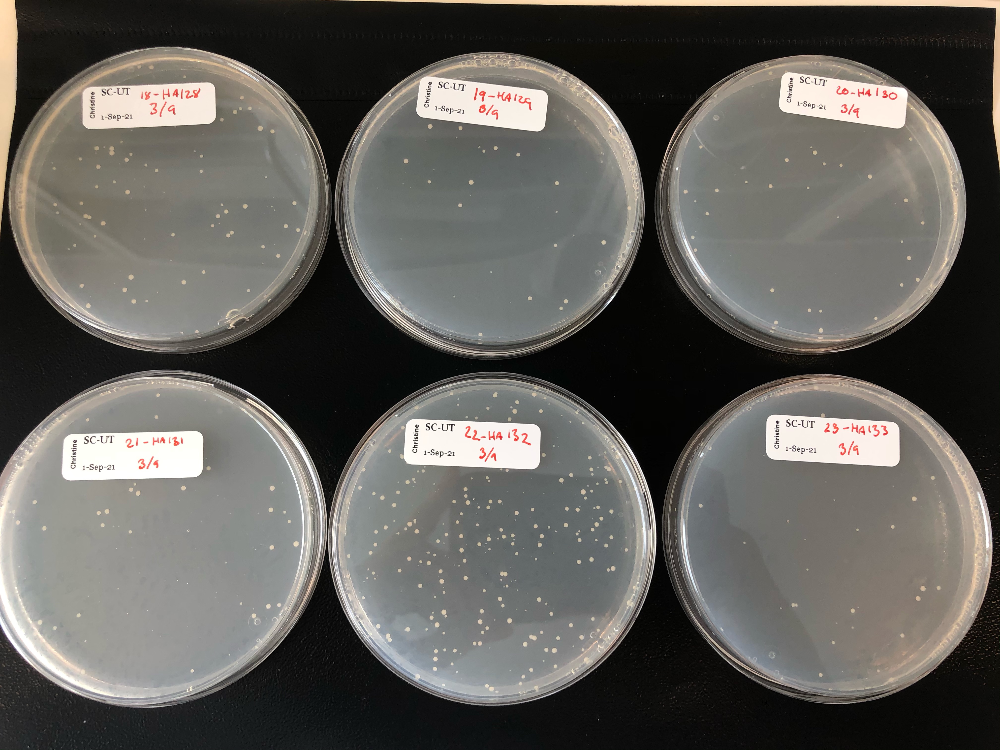

In [96]:
IPython.core.display.Image('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09-03_18-23.jpeg', width=400)

A possible explanation for the hight n.ctr could be that we add the trp in a plasmid, so they will be able to survive if they either make non homologus end joining or if they are never cut. If we have way to many cells pr gRNA, then these will never be cut, and then they will be able to survive, since we still have ura in the plasmid. 

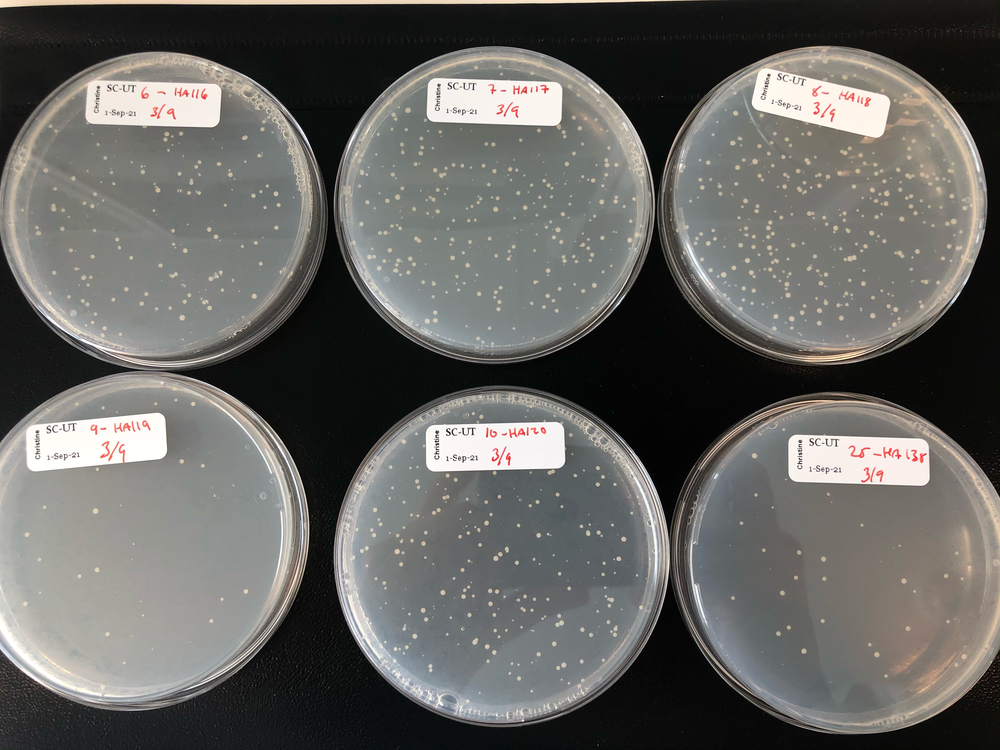

In [97]:
IPython.core.display.Image('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09-03_6-10_25.jpeg', width=400)

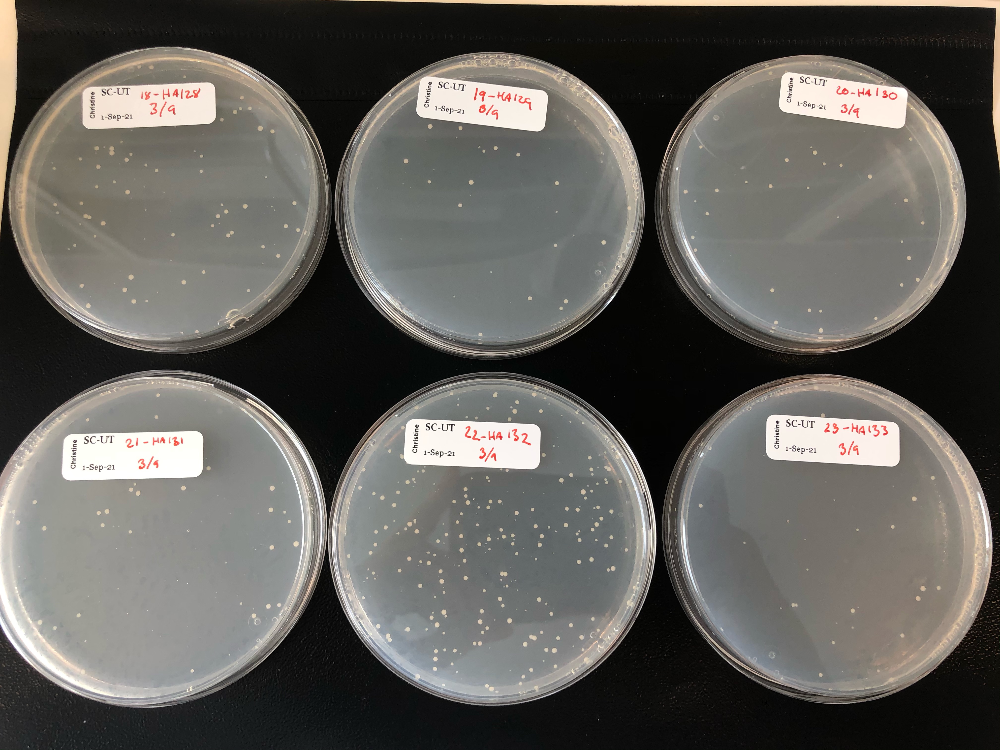

In [98]:
IPython.core.display.Image('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09-03_18-23.jpeg', width=400)

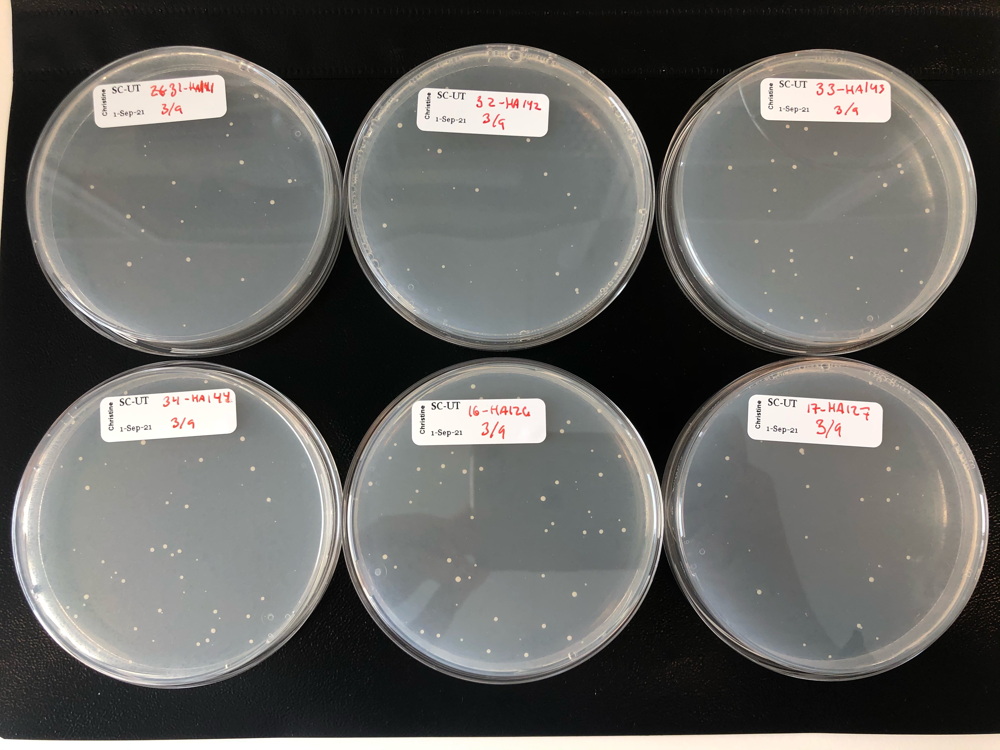

In [99]:
IPython.core.display.Image('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09-03_31-34_16-17.jpeg', width=400)

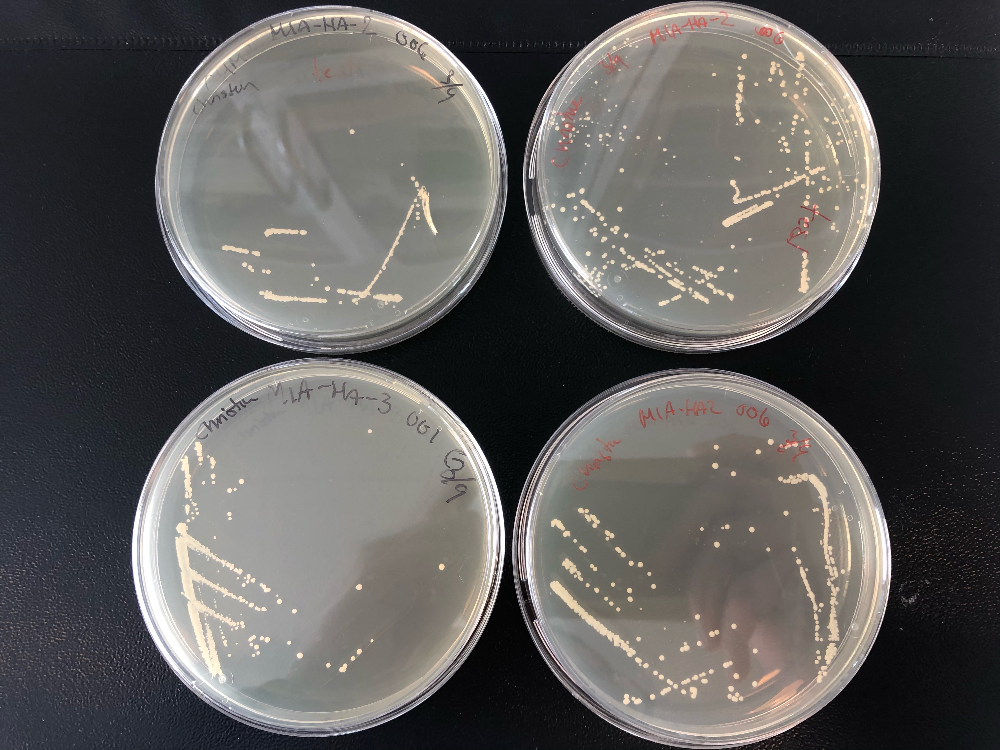

In [100]:
IPython.core.display.Image('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09-03_restreat_HA2HA3.jpeg', width=400)

All gRNA plasmid was used, and a new batch was made. Promoters are pooled again.
the parts were pooled, but Ara suddently had very low amounts

### Second transformation (yp54)

In [101]:
#Second transformation
transf_idx_2 = list(range(0,5)) + list(range(10,15)) + list(range(25,30))+list(range(34,38))

# names
reaction_names_2 = [reaction_names[i] for i in transf_idx_2]

# reaction participants
reaction_participants_2 = [reaction_participants[i] for i in transf_idx_2]

# Media
media_2 = [media[i] for i in transf_idx_2]

# wanted amounts in nano mol
new_dict_with_wanted_amounts2 = transformation_partitipants(reaction_participants_2,
                                                            sgRNA_plasmid_name='pESC-URA-gRNA_XI2-2',
                                                            sgRNA_plasmid_conc= 0.00025  )

In [102]:
# Make transfomation DNA mixes
transf_names_2 = transformation_mix(reaction_names_2, 
                                    reaction_participants_2,
                                    wanted_amounts = new_dict_with_wanted_amounts2,
                                    water_dna_p_reac = 74, media = media_2)

transf_names_2 = transf_names_2.set_index([pd.Index([str(ID + 1) for ID in transf_idx_2])])

#### Transformation table 2

In [103]:
# Print transformation mix DNA
transf_names_2

,name,UP_XI-2,VminG8H_tADH1,seq_3bqXE4zg,CroCPR_tCYC1,...,OeuG8H_tADH1,pL_01_C2_(pRS414-TRP),pL_01_C4_(pRS416-URA),water,plate on
1,HA111,1.8,12.0,3.4,5.3,...,NaN,NaN,NaN,32.4,SC-UT
2,HA112,1.8,12.0,3.4,NaN,...,NaN,NaN,NaN,20.3,SC-UT
3,HA113,1.8,12.0,3.4,NaN,...,NaN,NaN,NaN,31.1,SC-UT
4,HA114,1.8,12.0,3.4,NaN,...,NaN,NaN,NaN,16.1,SC-UT
5,HA115,1.8,12.0,3.4,NaN,...,NaN,NaN,NaN,15.4,SC-UT
...,...,...,...,...,...,...,...,...,...,...,...
30,HA140,1.8,NaN,3.4,NaN,...,14.0,NaN,NaN,18.3,SC-UT
35,HA145,1.8,NaN,3.4,NaN,...,14.0,NaN,NaN,30.1,SC-UT
36,n.ctr,NaN,NaN,NaN,NaN,...,NaN,15.6,NaN,45.7,SC-UT
37,p.ctr,NaN,NaN,NaN,NaN,...,NaN,15.6,15.9,42.5,SC-UT


#### Calculate volume of each part and how much wat should be used

In [104]:
transf_names_2.sum(numeric_only = True)

UP_XI-2                   28.8
VminG8H_tADH1             60.0
seq_3bqXE4zg              54.4
CroCPR_tCYC1              15.9
seq_3HMRtcpy              73.6
                         ...  
CroG8H_tADH1              11.4
OeuG8H_tADH1              42.0
pL_01_C2_(pRS414-TRP)     31.2
pL_01_C4_(pRS416-URA)     15.9
water                    593.1
Length: 20, dtype: float64

In [105]:
#Print tranforamation mix
calculate_volumes(vol_p_reac = 360, 
        no_of_reactions = 20,
        standard_reagents = ["PEG", "LiAc_1M", "ssDNA", "water_dna"],
        standard_volumes = [240, 36, 10, 74])

,vol_p_reac,vol_p_20_reac
PEG,240.0,4800.0
LiAc_1M,36.0,720.0
ssDNA,10.0,200.0
water_dna,74.0,1480.0
Total,360.0,7200.0


At 9 o'clock, 3 different OD's were inoculated
- first: from 10X -> OD 0..204*2 = 0.408 ( 8.40)
- second: from OD 10X wihite caps_ 0.052*2 = 0.208 (around 9)
- third: 0.482 from 1X kolbe (Around 9))

at 12.10:_ first 0.233*4 = 0.932

at 12.25 the same was 1.024 -> used in transfomraiton

the second was 0.206*4 = 0.824 (just below one doubling time - 

third was 0.155*4 = 062 - very high, aronuid 2 doubeling times - something must have been wrong. 


Was inoculated at 15.00 with 4 ml of OD 1 pr transfomraion  this is half the amount used in the last trasnformation

#### Results for strain MIA-111-...

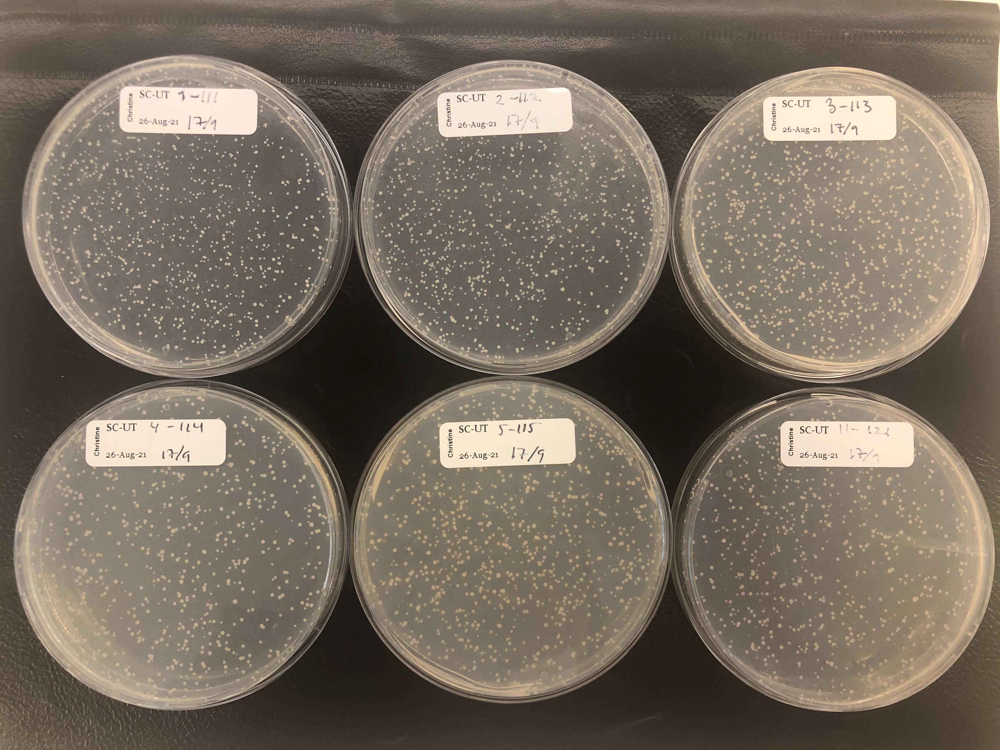

In [106]:
IPython.core.display.Image('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/Trans_17-09_1-11.jpeg', width=400)

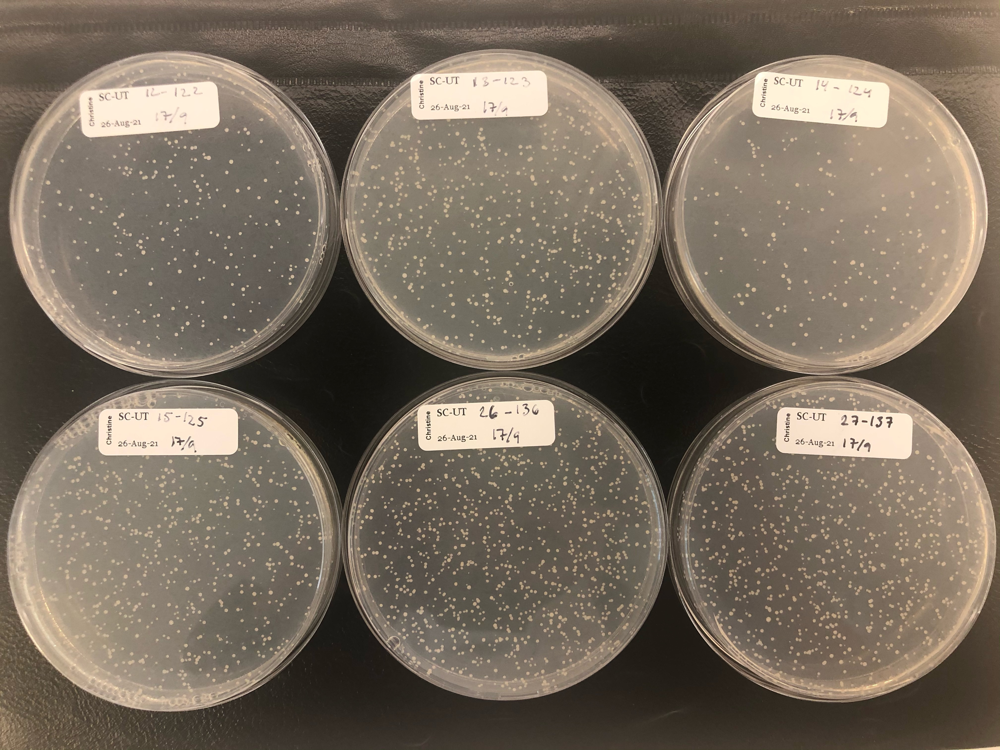

In [107]:
IPython.core.display.Image('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/Trans_17-09_12-27.jpeg', width=400)

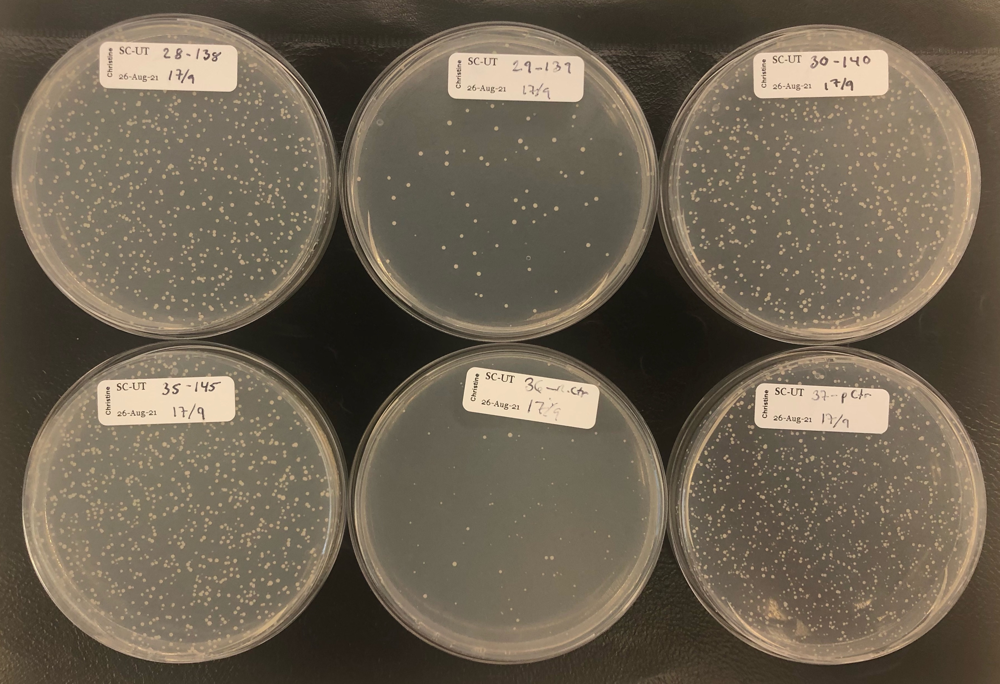

In [108]:
IPython.core.display.Image('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/Trans_17-09_28-37.jpeg', width=400)

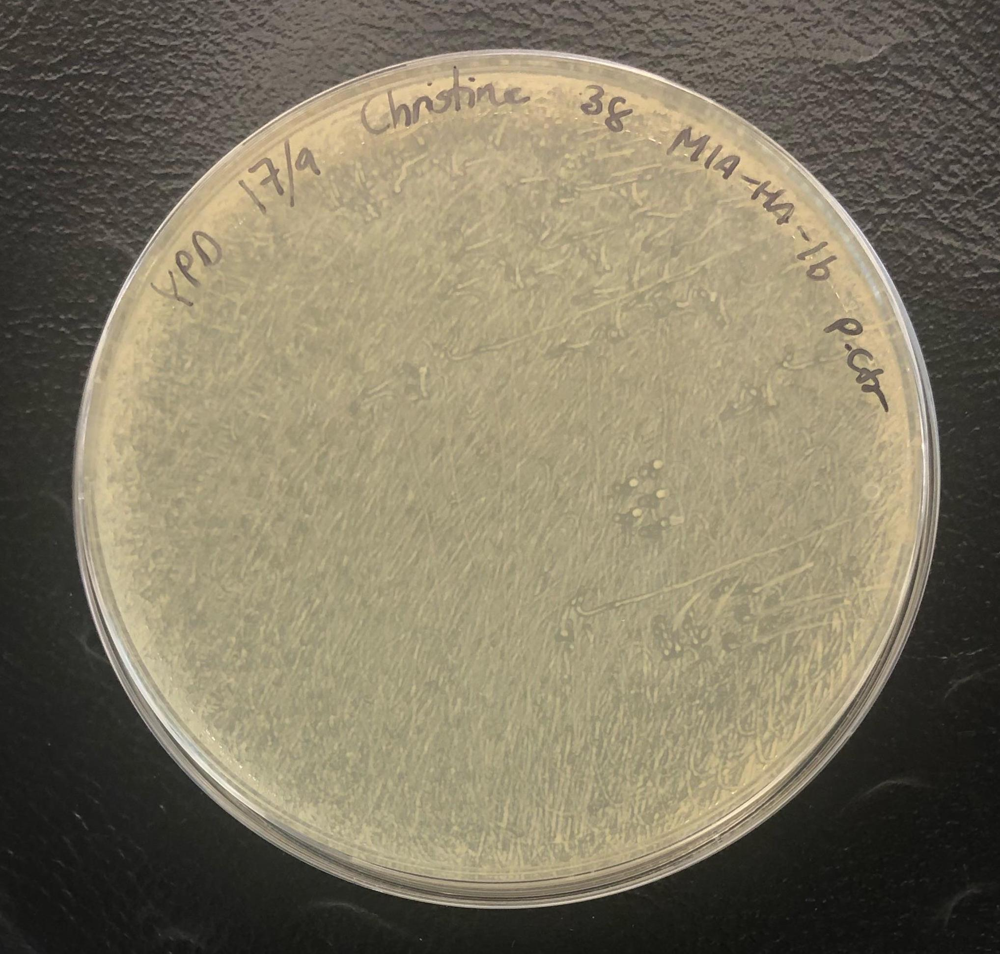

In [109]:
IPython.core.display.Image('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/Trans_17-09_38.jpeg', width=400)

This time the transformations had many more colonies that usual, and the gRNA negative control only had very few, which is different from all the other transformations. 


### 6.3 Import plate designs for colony picking

In [110]:
#lcms = pathlib.Path("G8H_CPR_library/Data/raw/023_LC-MS/").resolve()
yp53 = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="MIA-HA-116-120_126-135_141_yp53").reset_index(drop=True)
yp54 = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="111-115_121-125_136-140-145yp54").reset_index(drop=True)
yp53.tail()

,position,Sample name,Cellular compartment,Medium,Sample Type,...,Operator Name,Replicate #,Strain,Genotype,Date of sampling
91,H08,MIA-HA...,NaN,NaN,NaN,...,NaN,1.0,MIA-HA...,,202109...
92,H09,MIA-HA...,NaN,NaN,NaN,...,NaN,2.0,MIA-HA...,,202109...
93,H10,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,,202109...
94,H11,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,,202109...
95,H12,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN


In [111]:
yp53['prow'] = yp53['position'].str.slice(stop=-2)
yp53['pcol'] = yp53['position'].str.slice(start=-2)
plate_plot(yp53, 'Strain')

Strain                                              ...             \
pcol         01         02         03         04         05  ...         08   
prow                                                         ...              
A     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
B     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
C     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
D     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
E     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
F           NaN        NaN        NaN        NaN        NaN  ...        NaN   
G     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
H     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  n.ctr(36)  ...  MIA-HA...   

                                                  
pcol         09         10         11         12  
prow                                              
A     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
B     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
C     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
D     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
E     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
F           NaN        NaN        NaN        NaN  
G     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
H     MIA-HA...        NaN        NaN        NaN  

[8 rows x 12 columns]

In [112]:
yp54['prow'] = yp54['position'].str.slice(stop=-2)
yp54['pcol'] = yp54['position'].str.slice(start=-2)
plate_plot(yp54, 'Strain')

Strain                                              ...             \
pcol         01         02         03         04         05  ...         08   
prow                                                         ...              
A     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
B     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
C     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
D     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
E     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
F     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
G      MIA-HA-1   MIA-HA-1   MIA-HA-1        NaN        NaN  ...        NaN   
H           NaN        NaN        NaN        NaN        NaN  ...  MIA-CH-A2   

                                                  
pcol         09         10         11         12  
prow                                              
A     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
B     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
C     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
D     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
E     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
F     MIA-HA...  MIA-HA...  MIA-HA...   MIA-HA-1  
G           NaN        NaN        NaN        NaN  
H     MIA-CH-A2  MIA-CH-A2   MIA-CM-3      BLANK  

[8 rows x 12 columns]

# 7. Colony PCR

1.	Pick 4 colonies from all  plates and inoculate in 150 uL SC-UT, microtiter plate , grow ON in the 30oC shaker 300rpm
2.	Transfer 50ul of ON culture to 96 PCR plate, add 60ul of glycerol to the remaining 100ul. Freeze. 

3.	Make gDNA prep in 96 PCR plates

    a.	Spin down 50 µL of ON culture (2200 g, 5 min), remove the supernatant with sucker

    b.	Suspend the cells in 40 µL lysis buffer (200mM LiOAc, 1 % SDS solution).
        - (Prepare stock sol. 0.22 LiAc and mix 900 μl of it with 100 μl of 10% SDS) 
        - for the 96 well plate  0.22 LiAc well plate 3600 μl plus 400 μl of 10%SDS)

    c.	Incubate 15 min 75oC (PCR machine or heating block)

    d.	Add 120 µL EtOH (Absolute), mix

    e.	Spin down DNA and cell debris at 2200 g for 5 minutes, remove the supernatant -suck

    f.	Add 150 µL 70% EtOH, mix

    g.	Spin down DNA and cell debris at 2200 g for 5 minutes, remove the supernatant- suck

    h.	Dry the 96 well plate (in 37oC Incubator) 

    i.	Add 30 µL water or NE buffer, pipet up and down to dissolve the pellet
    
    j.	Centrifuge and remove 20ul to the new plate / safe gDNA
    
    k.  spin to remove air bubbles


 PLEASE NOTE: when removing the sticker lid, be very careful not to splash! when removing, have it a 180 degrees angle, wear gloves and kepp a tight grap close to the sticking site
 



In [113]:
# importing the primers 
pad_pG8H_fw2 =get_dna_from_box_name('pad_pG8H_fw2','primer_box', database_path = 'G8H_CPR_library/data/06-lims/csv_database/')
tADH1_160_rv = get_dna_from_box_name('tADH1_160_rv','primer_box', database_path = 'G8H_CPR_library/data/06-lims/csv_database/')

pad_pCPR_fw2 =get_dna_from_box_name('pad_pCPR_fw2','primer_box', database_path = 'G8H_CPR_library/data/06-lims/csv_database/')
tCYC1_150_rv = get_dna_from_box_name('tCYC1_150_rv','primer_box', database_path = 'G8H_CPR_library/data/06-lims/csv_database/')

In [114]:
#Importing the strain
HA2 = SeqIO.read("G8H_CPR_library/data/03-strain_sequences/background_and_controls/HA2.fasta", 'fasta')
HA2.annotations['topology']='linear'
HA2

SeqRecord(seq=Seq('GTTTGTAGTTGGCGGTGGAGCCAGCAGTGGCTACAATAACCAATATCAGTGTGG...CTC'), id='seq_sJ1saBKK', name='seq_sJ1saBKK', description='seq_sJ1saBKK <unknown description>', dbxrefs=[])

In [115]:
#Primers for colony PCR
pad_pG8H_fw2  = pad_pG8H_fw2
tADH1_160_rv = tADH1_160_rv #224

pad_pCPR_fw2  = pad_pCPR_fw2
tCYC1_150_rv = tCYC1_150_rv #225

# Background strain. As we do not know the actual genotype (promoter combination) of the individual library colonies we are using a similar genotype to simulate PCR length.
# As the two primer pairs each should yield the amplicon of a given length just two pcr's are simulated out of 2x140 amplifications
# We are also sequencing MIA-CM-3 and MIA-CH-A2 as controls

HA2 = HA2

#Amplify G8H and CPR amplicon
G8H_amplicon = pydna.amplify.pcr(tADH1_160_rv, pad_pG8H_fw2, HA2)
G8H_amplicon.name = "HA111-145 G8H"
G8H_amplicon.annotations['batches'] = [{'location':"yp53"}]

CPR_amplicon = pydna.amplify.pcr(pad_pCPR_fw2, tCYC1_150_rv, HA2)
CPR_amplicon.name = "HA111-145 CPR"
CPR_amplicon.annotations['batches'] = [{'location':"yp53"}]

#print lengths of the amplicons
len(G8H_amplicon), len(CPR_amplicon)

(2571, 3228)

In [116]:
#Print sequence of primers
tADH1_160_rv.seq, pad_pG8H_fw2.seq

(Seq('GAAATTCGCTTATTTAGAAGTGTC'), Seq('AGACAGGTCCATACGCC'))

Anneal at 47

In [117]:
#Print sequence of primers CPR
tCYC1_150_rv.seq, pad_pCPR_fw2.seq

(Seq('CTCCTTCCTTTTCGGTTAGAG'), Seq('TGCCTTATCGAATGGGCA'))

Anneal at 50


Print information about primers

In [118]:
tADH1_160_rv.annotations['batches'], pad_pG8H_fw2.annotations['batches']

([{'location': 'primer_box_rack_2_A6', 'volume': nan, 'concentration': nan}],
 [{'location': 'primer_box_rack_2_C2', 'volume': 10.0, 'concentration': 10.0}])

In [119]:
tCYC1_150_rv.annotations['batches'], pad_pCPR_fw2.annotations['batches']

([{'location': 'primer_box_rack_2_A9', 'volume': nan, 'concentration': nan}],
 [{'location': 'primer_box_rack_2_C3', 'volume': 10.0, 'concentration': 10.0}])

In [120]:
from teemi.build.PCR import pcr_locations

In [121]:
#print pcr infomration
pcr_locations([G8H_amplicon,CPR_amplicon])

,location,name,template,fw,rv
0,yp53,HA111-...,yp53,primer...,primer...
1,yp53,HA111-...,yp53,primer...,primer...


In [122]:
# PCR mix for the first transfomraiton round for each amplification site (G8H and CPR)
# make 81 * 10 % extra to account for pipetting error 
n = 81
no_of_react = n + n/10
calculate_volumes(vol_p_reac = 30, 
        no_of_reactions = no_of_react,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_89.1_reac
Template,0.6,53.46
Primer 1,1.5,133.65
Primer 2,1.5,133.65
H20,11.4,1015.74
Pol,15.0,1336.50
Total,30.0,2673.00


In [123]:
# PCR mix for the second transfomrtion round for each amplification site (G8H and CPR)
# make x * 10 % extra to account for pipetting error 
n = 77
no_of_react = n + n/10
calculate_volumes(vol_p_reac = 30, 
        no_of_reactions = no_of_react,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_84.7_reac
Template,0.6,50.82
Primer 1,1.5,127.05
Primer 2,1.5,127.05
H20,11.4,965.58
Pol,15.0,1270.50
Total,30.0,2541.00


In [124]:
# The total amount needed
n = 158
no_of_react = n + n/10
calculate_volumes(vol_p_reac = 30, 
        no_of_reactions = no_of_react,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_173.8_reac
Template,0.6,104.28
Primer 1,1.5,260.70
Primer 2,1.5,260.70
H20,11.4,1981.32
Pol,15.0,2607.00
Total,30.0,5214.00


PCR:
run two different PCR's 
- polymerase: OneTq 60 sek/kb
- Program: touch down
- Annealing temp:
    - 51/54
- Elongation time: 
    - 2:34/3:13

 Expected lenght of the HA111-145 G8H is : 2571 bp
 Expected lenght of the HA111-145 CPR is : 3228 bp


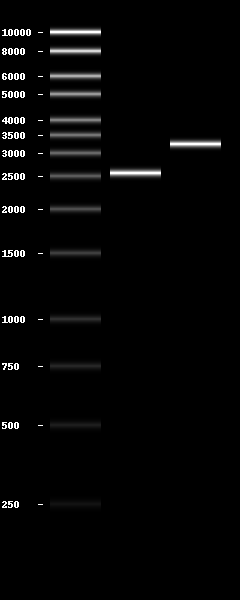

In [125]:
bands = [G8H_amplicon, CPR_amplicon]
for band in bands:
    print(f' Expected lenght of the {band.name} is : {len(band.seq)} bp')
pydna.gel.gel([pydna.ladders.GeneRuler_1kb,*[[band] for band in bands]])

During genomic purification I spilled some, so some of them have a little less volume. This might have spilled into other wells, but this is doubtfull. Also, some pellet came into the last bit from A's. 

In [126]:
#Print plate designs for PCRs 
yp53_PCR_1 = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="53_PCR_1").reset_index(drop=True)
yp53_PCR_2 = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="53_PCR_2").reset_index(drop=True)

In [127]:
yp53_PCR_1['prow'] = yp53_PCR_1['PCR_pos'].str.slice(stop=-2)
yp53_PCR_1['pcol'] = yp53_PCR_1['PCR_pos'].str.slice(start=-2)
plate_plot(yp53_PCR_1, 'Plate position')

Plate position                      ...                         
pcol             01   02   03   04   05  ...   08   09   10   11   12
prow                                     ...                         
A           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN
B           NaN      A01  A02  A03  A04  ...  A07  A08  A09  A10  NaN
C           NaN      A11  A12  B01  B02  ...  B05  B06  B07  B08  NaN
D           NaN      B09  B10  B11  B12  ...  C03  C04  C05  C06  NaN
E           NaN      C07  C08  C09  C10  ...  D01  D02  D03  D04  NaN
F           NaN      D05  D06  D07  D08  ...  D11  D12  E01  E02  NaN
G           NaN      E03  E04  E05  E06  ...  E09  E10  E11  E12  NaN
H           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN

[8 rows x 12 columns]

In [128]:
yp53_PCR_2['prow'] = yp53_PCR_2['PCR_pos'].str.slice(stop=-2)
yp53_PCR_2['pcol'] = yp53_PCR_2['PCR_pos'].str.slice(start=-2)
plate_plot(yp53_PCR_2, 'Plate position')

Plate position                      ...                         
pcol             01   02   03   04   05  ...   08   09   10   11   12
prow                                     ...                         
A           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN
B           NaN      G01  G02  G03  G04  ...  G07  G08  G09  G10  NaN
C           NaN      G11  G12  H01  H02  ...  H05  H06  H07  H08  NaN
D           NaN      H09  H20  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN
E           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN
F           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN
G           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN
H           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN

[8 rows x 12 columns]

## 7.1 Colony PCR - yp53


Press the links below to see the results

### CPR_colony_PCR_1stgel

In [129]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09_08_CPR_colony_PCR_1stgel_new.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09_08_CPR_colony_PCR_1stgel_new.jpg

### G8H_colony_PCR_1stgel

In [130]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09_08_G8H_colony_PCR_1stgel_new.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09_08_G8H_colony_PCR_1stgel_new.jpg

### CPR_colony_PCR_2nd_gel

In [131]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09_08_CPR_colony_PCR_2ndgel_new.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09_08_CPR_colony_PCR_2ndgel_new.jpg

### G8H_colony_PCR_2nd_gel

In [132]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09_08_G8H_colony_PCR_2ndgel_new.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-09_08_G8H_colony_PCR_2ndgel_new.jpg

## 7.1 Colony PCR - yp53

In [133]:
#PCR plate design for plate yp54
yp54_PCR_1 = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="54_PCR_1").reset_index(drop=True)
yp54_PCR_2 = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="54_PCR_2").reset_index(drop=True)

In [134]:
yp54_PCR_1['prow'] = yp54_PCR_1['PCR_pos'].str.slice(stop=-2)
yp54_PCR_1['pcol'] = yp54_PCR_1['PCR_pos'].str.slice(start=-2)
plate_plot(yp54_PCR_1, 'Plate position')

Plate position                      ...                         
pcol             01   02   03   04   05  ...   08   09   10   11   12
prow                                     ...                         
A           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN
B           NaN      A01  A02  A03  A04  ...  A07  A08  A09  A10  NaN
C           NaN      A11  A12  B01  B02  ...  B05  B06  B07  B08  NaN
D           NaN      B09  B10  B11  B12  ...  C03  C04  C05  C06  NaN
E           NaN      C07  C08  C09  C10  ...  D01  D02  D03  D04  NaN
F           NaN      D05  D06  D07  D08  ...  D11  D12  E01  E02  NaN
G           NaN      E03  E04  E05  E06  ...  E09  E10  E11  E12  NaN
H           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN

[8 rows x 12 columns]

In [135]:
yp54_PCR_2['prow'] = yp54_PCR_2['PCR_pos'].str.slice(stop=-2)
yp54_PCR_2['pcol'] = yp54_PCR_2['PCR_pos'].str.slice(start=-2)
plate_plot(yp54_PCR_2, 'Plate position')

Plate position                      ...                         
pcol             01   02   03   04   05  ...   08   09   10   11   12
prow                                     ...                         
A           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN
B           NaN      F01  F02  F03  NaN  ...  NaN  NaN  NaN  NaN  NaN
C           NaN      F04  F05  F06  NaN  ...  NaN  NaN  NaN  NaN  NaN
D           NaN      F07  F08  F09  NaN  ...  NaN  NaN  NaN  NaN  NaN
E           NaN      F10  F11  F12  NaN  ...  NaN  NaN  NaN  NaN  NaN
F           NaN      G01  G02  G03  NaN  ...  NaN  NaN  NaN  NaN  NaN
G           NaN      H20  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN
H           NaN      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN

[8 rows x 12 columns]

### CPR_colony_PCR_1stgel_2ntrans

In [136]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-23_09_CPR_colony_PCR_1stgel_2ntrans.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-23_09_CPR_colony_PCR_1stgel_2ntrans.jpg

### G8H_colony_PCR_1stgel_2ndtrans

In [137]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-23_09_G8H_colony_PCR_1stgel_2ndtrans.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-23_09_G8H_colony_PCR_1stgel_2ndtrans.jpg

### CPR_colony_PCR_2ndgel_2ntrans

In [138]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-23_09_CPR_colony_PCR_2ndgel_2ntrans.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-23_09_CPR_colony_PCR_2ndgel_2ntrans.jpg

### G8H_colony_PCR_2ndgel_2ntrans

In [139]:
IPython.display.FileLink('G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-23_09_G8H_colony_PCR_2ndgel_2ntrans.jpg')

/Users/lucaslevassor/projects/teemi/colab_notebooks/G8H_CPR_library/data/05-gel_bioimager_nanophotometer/processed/bioimager/2021-23_09_G8H_colony_PCR_2ndgel_2ntrans.jpg

# 8. Preparing Analytics

Preculture was innoculated noon the 14th 20 ul + 80 ypd - feed
culture inokultaed 16th at 14:50 - 10 ul culture, 500 ul YPD + feed 

TO be taken out the 22nd at 14:50

**MIA-HA-111-145_analytics_experiment**

Strains  
- YP53
    - (4 colonies * 19 plates) + 2x MIA-HA-2, 2x MIA-HA-3, 4x MIA-CH-A2, 1xMIA-CM-3 and 1xblank 
-  YP54
    - (4 colonies * 16 plates) + 2x MIA-HA-2, 2x MIA-HA-3, 4x MIA-CH-A2, 1xMIA-CM-3 and 1xblank 

Media feed: 0.2 mM geraniol & 1 mM tryptamine
1. YP + 2 % glucose + feed

Sampling times:
1. One: Day: 6

For each sampling time: 
1. Cultivation 30C, 300 rpm:
2. (Monday 10/5): Inoculate precultures. Transfer 10 of YP48 g.stock to 90 media (-feed).
3. (Wednesday 12, at 11): Inoculate maincultures. Transfer 10 of preculture to 500 media
4. (Tuesday 18, at 11): 
    Sample
     1. Transfer 10 of mainculture into 140 to measure OD (in incubator while measuring) # Skipped due to dense cultures
     2. Transfer 200 into new 96 well plate,
     3. Add 20 uL 10 mg/L caffeine stock
     4. Transfer 220 onto filter in collection plate, centrifuge (2000 g x 1 min; put collection plate in -80C) 
     5. Measure MIAs (extracellular loganin)
    Prepare standards (in its own 96wellplate)
        1. Prepare [standards](/files/reports/spreadsheets/20200728_MIA_standards_prep_scheme_v2_std_v13.xlsx)
        2. Transfer X ul Std_MM_v13 onto filter in collection plate, centrifuge (2000 g x 1 min; put collection plate in -80C)      
5. (TBD): Khem run plate
6. (TBD): Data analysis

YPD + feed
1. stocks (in absolute ethanol)
    - 100 mM geraniol (Molar mass 154.253 g·mol−1, Density 0.889 g·cm-3)
        - 154.253 mg (or 173.5 µl) in 10 mL
            $$ \frac{\frac{x mg}{154.253 mg/mmol}}{10 ml} = 0.100 mmol/ml $$
            $$0.100 mmol/ml * 10 ml * 154.253 mg/ml = 154.253 mg$$
            $$ \frac{154.253 mg}{889mg/cm} * 1000 ul/ml = 173.5 ul $$  
    - 1000 mM tryptamine (Molar mass 160.220 g·mol−1) 
        - 160.220 mg in 1 mL
            $$ 1 mmol/ml * 1 ml * 160.220 mg/mmol = 160.220 mg$$

2. Add x to 100 ml YPD
    - geraniol: 200 µl 100 mM to make 0.2 mM (500x dilution)
       $$ \frac{100000 ul}{500} = 200 ul $$
    - tryptamine: 100 µl 1000 mM to make 1 mM (1000x dilution)
       $$ \frac{100000 ul}{1000} = 100 ul $$

In [140]:
#YP53 was reallocated due to some erros during filling in the plate
yp53_reallocated = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="yp53_reallocated").reset_index(drop=True)
yp53_reallocated.tail()

,position,Sample name,Cellular compartment,Medium,Sample Type,...,Strain,Genotype,Date of sampling,old position,plate
91,H08,202109...,Extrac...,YPD,Specimen,...,MIA-CH-A2,NaN,202109...,F02,yp53
92,H09,202109...,Extrac...,YPD,Specimen,...,MIA-CH-A2,NaN,202109...,F03,yp53
93,H10,202109...,Extrac...,YPD,Specimen,...,MIA-CH-A2,NaN,202109...,F04,yp53
94,H11,202109...,Extrac...,YPD,Specimen,...,MIA-CM-3,NaN,202109...,F05,yp53
95,H12,202109...,Extrac...,YPD,Blank,...,BLANK,NaN,202109...,F06,yp53


In [141]:
yp53_reallocated['prow'] = yp53_reallocated['position'].str.slice(stop=-2)
yp53_reallocated['pcol'] = yp53_reallocated['position'].str.slice(start=-2)
plate_plot(yp53_reallocated, 'old position')

old position                      ...                         
pcol           01   02   03   04   05  ...   08   09   10   11   12
prow                                   ...                         
A           A01    A02  A03  A04  A05  ...  A08  A09  A10  A11  A12
B           B01    B02  B03  B04  B05  ...  B08  B09  B10  B11  B12
C           C01    C02  C03  C04  C05  ...  C08  C09  C10  C11  C12
D           D01    D02  D03  D04  D05  ...  D08  D09  D10  D11  D12
E           E01    E02  E03  E04  E05  ...  E08  E09  E10  E11  E12
F           G01    G02  G03  G04  G05  ...  G08  G09  G10  G11  G12
G           H01    H02  H03  H04  H05  ...  H08  H09  NaN  NaN  NaN
H           NaN    NaN  NaN  NaN  NaN  ...  F02  F03  F04  F05  F06

[8 rows x 12 columns]

#### PlateDesign of yp53+yp54

In [142]:
plate_plot(yp53_reallocated, 'Strain')

Strain                                              ...             \
pcol         01         02         03         04         05  ...         08   
prow                                                         ...              
A     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
B     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
C     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
D     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
E     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
F     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
G     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  n.ctr(36)  ...  MIA-HA...   
H           NaN        NaN        NaN        NaN        NaN  ...  MIA-CH-A2   

                                                  
pcol         09         10         11         12  
prow                                              
A     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
B     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
C     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
D     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
E     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
F     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
G     MIA-HA...        NaN        NaN        NaN  
H     MIA-CH-A2  MIA-CH-A2   MIA-CM-3      BLANK  

[8 rows x 12 columns]

In [143]:
plate_plot(yp54, 'Strain')

Strain                                              ...             \
pcol         01         02         03         04         05  ...         08   
prow                                                         ...              
A     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
B     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
C     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
D     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
E     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
F     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  ...  MIA-HA...   
G      MIA-HA-1   MIA-HA-1   MIA-HA-1        NaN        NaN  ...        NaN   
H           NaN        NaN        NaN        NaN        NaN  ...  MIA-CH-A2   

                                                  
pcol         09         10         11         12  
prow                                              
A     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
B     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
C     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
D     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
E     MIA-HA...  MIA-HA...  MIA-HA...  MIA-HA...  
F     MIA-HA...  MIA-HA...  MIA-HA...   MIA-HA-1  
G           NaN        NaN        NaN        NaN  
H     MIA-CH-A2  MIA-CH-A2   MIA-CM-3      BLANK  

[8 rows x 12 columns]

Save the preculture for analytics in a new 53

#### How many samples did we generate? 

In [144]:
yp53_reallocated = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="yp53_reallocated").reset_index(drop=True)
yp54 = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="111-115_121-125_136-140-145yp54").reset_index(drop=True)

yp53_yp53_combined = pd.concat([yp53_reallocated, yp54])

In [145]:
## negative controls
negative_cotrols_no_inserts = len(yp53_yp53_combined[yp53_yp53_combined['Sample name'] == '20210922n.ctr(36)_1'])+ len(yp53_yp53_combined[yp53_yp53_combined['Sample name'] == 'n.ctr'])
blanks = len(yp53_yp53_combined[yp53_yp53_combined['Sample name'] == '20210922BLANK_1'])
print(f'Number of blank samples : {blanks}')
print(f'Number of negative controls : {negative_cotrols_no_inserts}')

Number of blank samples : 2
Number of negative controls : 2


In [146]:
## positve controls
controls_MIA_CM3_A2 = len(yp53_yp53_combined[yp53_yp53_combined['Strain'] == 'MIA-CM-3'])+ len(yp53_yp53_combined[yp53_yp53_combined['Strain'] == 'MIA-CH-A2'])
controls_MIA_HA1_3 = len(yp53_yp53_combined[yp53_yp53_combined['Strain'] == 'MIA-HA-3_001']) +len(yp53_yp53_combined[yp53_yp53_combined['Strain'] == 'MIA-HA-1'])  + len(yp53_yp53_combined[yp53_yp53_combined['Strain'] == 'MIA-HA-2_006'])  
print(f'Number of controls_MIA_CM3_A2 : {controls_MIA_CM3_A2}')
print(f'Number of controls_MIA_HA1_3 : {controls_MIA_HA1_3}')

Number of controls_MIA_CM3_A2 : 10
Number of controls_MIA_HA1_3 : 12


In [147]:
# all controls
all_controls_and_blanks = negative_cotrols_no_inserts+ blanks + controls_MIA_CM3_A2 + controls_MIA_HA1_3
all_controls_and_blanks

26

In [148]:
# Making empty cells into NaN
yp53_yp53_combined["Sample name"].fillna('NaN', inplace = True)
# Total samples
total_samples = len(yp53_yp53_combined[yp53_yp53_combined['Sample name'] != 'NaN'])
print(f'Number samples : {total_samples}')
print(f'Number samples without controls : {total_samples-all_controls_and_blanks}')

Number samples : 168
Number samples without controls : 142


## 8.1 Sequencing
Sequencing was perfomed with a plate sequencing kit for crude PCR products

In [149]:
yp53_PCR_to_seq = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="53PCR_til_sekventering").reset_index(drop=True)
yp54_PCR_to_seq = pd.read_excel('G8H_CPR_library/data/07-lcms/raw/plate_design/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="54PCR_til_sekventering").reset_index(drop=True)

In [150]:
yp53_PCR_to_seq['prow'] = yp53_PCR_to_seq['new_platepos/seq'].str.slice(stop=-2)
yp53_PCR_to_seq['pcol'] = yp53_PCR_to_seq['new_platepos/seq'].str.slice(start=-2)
plate_plot(yp53_PCR_to_seq, 'PCR_plate_pos')

PCR_plate_pos                                              ...  \
pcol            01         02         03         04         05  ...   
prow                                                            ...   
A     PCR_1_B02     PCR_1_B03  PCR_1_B04  PCR_1_B05  PCR_1_B06  ...   
B     PCR_1_C04     PCR_1_C05  PCR_1_C06  PCR_1_C07  PCR_1_C08  ...   
C     PCR_1_D06     PCR_1_D07  PCR_1_D08  PCR_1_D09  PCR_1_D10  ...   
D     PCR_1_E08     PCR_1_E09  PCR_1_E10  PCR_1_E11  PCR_1_F02  ...   
E     PCR_1_F10     PCR_1_F11  PCR_1_G02  PCR_1_G03  PCR_1_G04  ...   
F     PCR_2_B02     PCR_2_B03  PCR_2_B04  PCR_2_B05  PCR_2_B06  ...   
G     PCR_2_C04     PCR_2_C05  PCR_2_C06  PCR_2_C07  PCR_2_C08  ...   
H           NaN           NaN        NaN        NaN        NaN  ...   

                                                             
pcol         08         09         10         11         12  
prow                                                         
A     PCR_1_B09  PCR_1_B10  PCR_1_B11  PCR_1_C02  PCR_1_C03  
B     PCR_1_C11  PCR_1_D02  PCR_1_D03  PCR_1_D04  PCR_1_D05  
C     PCR_1_E03  PCR_1_E04  PCR_1_E05  PCR_1_E06  PCR_1_E07  
D     PCR_1_F05  PCR_1_F06  PCR_1_F07  PCR_1_F08  PCR_1_F09  
E     PCR_1_G07  PCR_1_G08  PCR_1_G09  PCR_1_G10  PCR_1_G11  
F     PCR_2_B09  PCR_2_B10  PCR_2_B11  PCR_2_C02  PCR_2_C03  
G     PCR_2_C11  PCR_2_D02        NaN        NaN        NaN  
H           NaN        NaN        NaN        NaN         QC  

[8 rows x 12 columns]

In [151]:
yp54_PCR_to_seq['prow'] = yp54_PCR_to_seq['Plate/seq position'].str.slice(stop=-2)
yp54_PCR_to_seq['pcol'] = yp54_PCR_to_seq['Plate/seq position'].str.slice(start=-2)
plate_plot(yp54_PCR_to_seq, 'PCR_plate_pos')

PCR_plate_pos                                              ...  \
pcol            01         02         03         04         05  ...   
prow                                                            ...   
A     PCR_1_B02     PCR_1_B03  PCR_1_B04  PCR_1_B05  PCR_1_B06  ...   
B     PCR_1_C04     PCR_1_C05  PCR_1_C06  PCR_1_C07  PCR_1_C08  ...   
C     PCR_1_D06     PCR_1_D07  PCR_1_D08  PCR_1_D09  PCR_1_D10  ...   
D     PCR_1_E08     PCR_1_E09  PCR_1_E10  PCR_1_E11  PCR_1_F02  ...   
E     PCR_1_F10     PCR_1_F11  PCR_1_G02  PCR_1_G03  PCR_1_G04  ...   
F     PCR_2_B02     PCR_2_B03  PCR_2_B04  PCR_2_B05  PCR_2_B06  ...   
G     PCR_2_C04     PCR_2_C05  PCR_2_C06        NaN        NaN  ...   
H           NaN           NaN        NaN        NaN        NaN  ...   

                                                             
pcol         08         09         10         11         12  
prow                                                         
A     PCR_1_B09  PCR_1_B10  PCR_1_B11  PCR_1_C02  PCR_1_C03  
B     PCR_1_C11  PCR_1_D02  PCR_1_D03  PCR_1_D04  PCR_1_D05  
C     PCR_1_E03  PCR_1_E04  PCR_1_E05  PCR_1_E06  PCR_1_E07  
D     PCR_1_F05  PCR_1_F06  PCR_1_F07  PCR_1_F08  PCR_1_F09  
E     PCR_1_G07  PCR_1_G08  PCR_1_G09  PCR_1_G10  PCR_1_G11  
F     PCR_2_B09  PCR_2_B10  PCR_2_B11  PCR_2_C02  PCR_2_C03  
G           NaN        NaN        NaN        NaN        NaN  
H           NaN        NaN        NaN        NaN         QC  

[8 rows x 12 columns]

Some wells had evaopuradet, and therefore, the PCRs below(yp53) were redone. 

In [152]:
from teemi.build.PCR import pcr_locations

In [153]:
pcr_locations([G8H_amplicon,CPR_amplicon])

,location,name,template,fw,rv
0,yp53,HA111-...,yp53,primer...,primer...
1,yp53,HA111-...,yp53,primer...,primer...


In [154]:
# for each amplification site (G8H and CPR)
# make 81 * 10 % extra to account for pipetting error 
n = 81
no_of_react = n + n/10
calculate_volumes(vol_p_reac = 35, 
        no_of_reactions = no_of_react,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_89.1_reac
Template,0.70,62.370
Primer 1,1.75,155.925
Primer 2,1.75,155.925
H20,13.30,1185.030
Pol,17.50,1559.250
Total,35.00,3118.500


PCR:
run two different PCR's 
- polymerase: OneTq 60 sek/kb
- Program: touch down
- Annealing temp:
    - 51/54
- Elongation time: 
    - 2:34/3:13

# 9. Casembler - assemble the dna for each strain

In [155]:
HA1.features[0].qualifiers

OrderedDict([('name', ['ID-903 (X-3-up-out-sq)']),
             ('color', ['#B7E6D7']),
             ('label', ['ID-903 (X-3-up-out-sq)'])])

In [156]:
## Updating features in HA1
for feature in HA1.features: 
    feature.qualifiers['name'] = feature.qualifiers['label']

In [157]:
# We have to add names to the qualifiers dict
for i in range(len(amplicon_matrix)):
    for j in range(len(amplicon_matrix[i])):
        for feature in amplicon_matrix[i][j].features: 
            feature.qualifiers['name'] = feature.qualifiers['label']

In [158]:
#Make connections bettween names and number codes
g8h = ["CacuG8H_tADH1", "OpumG8H_tADH1","CroG8H_tADH1","VminG8H_tADH1","SmusG8H_tADH1","RsepG8H_tADH1","OeuG8H_tADH1","CcalG8H_tADH1"]
g8h_no = ["1","2","3","4","5","6","7","8"]
g8h_trans = {}
for i in range(len(g8h)):
    g8h_trans[g8h[i]]=g8h_no[i]

pg8h = ["pCYC1", "pENO2","pPCK1","pRPL15B"]
pg8h_no = ["1","2","3","4"]
pg8h_trans = {}
for i in range(len(pg8h)):
    pg8h_trans[pg8h[i]]=pg8h_no[i]
    
pcpr = ["pCCW12", "pTPI1","pMLS1","pURE2"]
pcpr_no = ["5","6","7","8"]
pcpr_trans = {}
for i in range(len(pcpr)):
    pcpr_trans[pcpr[i]]=pcpr_no[i]
       
cpr = ["CroCPR_tCYC1", "AanCPR_tCYC1","AraCPR_tCYC1","CloCPR_tCYC1","RseCPR_tCYC1","AhuCPR_tCYC1","AniCPR_tCYC1","CacCPR_tCYC1","OeuCPR_tCYC1","CpoCPR_tCYC1"]
cpr_no = ["1","2","3","4","5","6","7","8","9","10"]
cpr_trans = {}
for i in range(len(cpr)):
    cpr_trans[cpr[i]]=cpr_no[i]

#Make combination codes
assembly_names = []
for i in range(len(amplicon_matrix)):
    assembly_names.append( g8h_trans[amplicon_matrix[i][1].annotations['template_name']]+"_"+ pg8h_trans[amplicon_matrix[i][2].annotations['template_name']] +"_"+ pcpr_trans[amplicon_matrix[i][3].annotations['template_name']] +"_"+ cpr_trans[amplicon_matrix[i][4].annotations['template_name']])


I already did this. It takes a approx ~4 min to assemble all the strains strains made in this targeted library here. 

In [159]:
casembler_logic = False

In [160]:
%%time
if casembler_logic: 
    #Create all possible assemblies from the given parameters
    assemble_strains = True
    if assemble_strains:
        assemblies = []
        for i, name in enumerate(assembly_names):
            parameters = {
           'bg_strain': HA1,
           'site_names': ["XI-2"],
           'gRNAs': [XI2_2_gRNA],
           'assembly_limits':[30],
           'verbose': False,
           'to_benchling': False  
           }       
            assembly = casembler(**{**parameters,
                                         'parts'          : [amplicon_matrix[i]],
                                         'assembly_names' : [name]
                                          })
            assemblies.append(assembly)
        assemblies

CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 4.05 µs


Already saved them to the designated folder